# 2-5 Layers defined

In [7]:
# List of imports neccessary to run the code

import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2

import time


Below, I have a series of classes in the format model_dip_[layers], where layers signifies the combined number of convolutional and upsampling layers in each class.

The convolutional layers for the classes change. However, what remains the same is that the class inherits from the nn.Module class, which is the base class for all neural network modules in Pytorch.

We have a constructor setup, and it defines the layers in this way:

1. the up1 is a convolutional layer that maintains the number of chanels when processing the input with a particular kernel size
2. the reLu function is used to introduce non-linearity to the model. And it's an inplace introduction, so that the argument is identified directly.

3. In layers that are only 2, they only have up1, and up6. up6 has the following: a conv2d layer to reduce the number of channels from 64 back to 1, reLu, batch normalization, and another upsampling step to match the output resolution to a desired target.

In layers 3 and above, we have additional up# steps, where 2D convolutional layers are applied, ReLU is introduced, batch normalization happens, and the final step is upsampling to double the spatial dimensions of the output.


Essentially up1-up6 are organized in sequences to execute the contained layers sequentially.



4.Each of the dip models, the final layer that has conv2d to reduce the dimensions back to 1, and sigmoid() function that bounds the output in the range [0,1].


The forward function then defines the forward pass of the model, and it calls all the layers defined in the constructor.



The main thing that changes in each of the models below is the number of layers called within the forward method itself. These classes are called in a later part of my code where I test the effect of additive vs multiplicative noise and their performance (in reconstructing images) at different levels.




In [8]:
# This is a DIP model, but specifically for 2 layers. By this, I mean I have 2 Conv+ReLU+Batch,and then a final Conv+Sigmoid layer.

import matplotlib.pyplot as plt

class model_dip_two_layers(nn.Module):
    def __init__(self):
        super(model_dip_two_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        # Layer 3: Conv+ReLU+Batch
        self.up3 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )
        self.up4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

         # Layer 4: Conv+ReLU+Batch
        self.up5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )


        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)

        x = self.up6(x)

        x = self.final(x)
        return x


In [9]:
# This is a DIP model, but specifically for 3 layers. By this, I mean I have 3 Conv+ReLU+Batch,and then a final Conv+Sigmoid layer.

import matplotlib.pyplot as plt

class model_dip_three_layers(nn.Module):
    def __init__(self):
        super(model_dip_three_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        # Layer 3: Conv+ReLU+Batch
        self.up3 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
           nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )
        self.up4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

         # Layer 4: Conv+ReLU+Batch
        self.up5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )


        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)

        x = self.up6(x)

        x = self.final(x)
        return x


In [8]:
# This is a DIP model, but specifically for 4 layers. By this, I mean I have 4 Conv+ReLU+Batch,and then a final Conv+Sigmoid layer.

import matplotlib.pyplot as plt

class model_dip_four_layers(nn.Module):
    def __init__(self):
        super(model_dip_four_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        # Layer 3: Conv+ReLU+Batch
        self.up3 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
           nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )
        self.up4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

         # Layer 4: Conv+ReLU+Batch
        self.up5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )


        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)

        x = self.up6(x)

        x = self.final(x)
        return x


In [9]:
# This is a DIP model, but specifically for 5 layers. By this, I mean I have 5 Conv+ReLU+Batch,and then a final Conv+Sigmoid layer.

import matplotlib.pyplot as plt

class model_dip_five_layers(nn.Module):
    def __init__(self):
        super(model_dip_five_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        # Layer 3: Conv+ReLU+Batch
        self.up3 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
           nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )
        self.up4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

         # Layer 4: Conv+ReLU+Batch
        self.up5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )


        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        x = self.up4(x)

        x = self.up6(x)

        x = self.final(x)
        return x


# Project_dip

In [10]:
# In thsi code, a function is created in order to use the deep image prior model(dip) from above.
# The function takes x_temp and layer as input, and outputs the output_np, the loss historu,
# and the time it took from start to finish to put the noisy image(x_temp) into the model for dip,
# and run dip, and denoise the image. The output_np represents the output of putting the image
# through the dip model - so essentially, the reconstructed image.

def project_DIP(x_temp, layer):
    n1,n2 = x_temp.shape

    # print('size input:', n1,n2)
    # sizen1 = size_input/16;
    # sizen1 = int(size_input / 16)
    # print("input_size",size_input )
    # print("sizen1", sizen1)
    sizen1 = int(n1/8)
    print(sizen1)
    input_tensor = torch.randn(1, 64, sizen1, sizen1)  # (batch_size, channels, height, width)

    print("input_tensor_size",  input_tensor.size())


    if not isinstance(x_temp, torch.Tensor):
        x_temp = torch.from_numpy(x_temp).float()   # Convert to tensor if it's a numpy array

    if(layer ==2):
      model = model_dip_two_layers()
    elif(layer ==3):
      model = model_dip_three_layers()
    elif (layer==4):
        model = model_dip_four_layers()
    elif(layer==5):
        model = model_dip_five_layers()
    else:
        model = model_dip_three_layers()



    optimizer = optim.Adam(model.parameters(), lr=0.05)
    criterion = nn.MSELoss()

    loss_history =[]
    start_time = time.time()
    num_steps=200
    for step in range(num_steps):
        optimizer.zero_grad()
        output=model(input_tensor)

        # print("output shape", output.shape)
        output_resized = F.interpolate(output, size=x_temp.shape[-2:], mode='bilinear', align_corners=False)

        # Then calculate the loss with the resized output
        loss = criterion(output_resized, x_temp)
        loss_history.append(loss.item())

        # loss = criterion(output,x_temp)
        loss.backward()
        optimizer.step()

        if step % 10 == 0:
            print(f"Step {step}, Loss: {loss.item()}")
    end_time = time.time()
    time_elapsed = end_time - start_time
    print("Time lapsed", time_elapsed)

    output_np = output.squeeze().detach().numpy()

    return output_np, loss_history, time_elapsed





# Testing Additive Noise

In [8]:
# In this code block, some of the common functions that are used throughout the different code blocks below are listed.


def save_figure_as_image(figure, filename):
    figure.savefig(filename)


image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]


# evaluates the psnr of the noisy image and the denoised image
def evaluate_psnr(clean_image, noisy_image, denoised_image):
    # Resize denoised image to match clean_image
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

# loads the images. Takes the paths of the images, and for each individual image path, it converts it to an array. Also,
# a normalization of [0,1] happens here. And incase the image is colored, it converts the image to grayscale
def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images


images = load_images(image_paths)

# Adding multiplicative noise to the clean image
def add_multiplicative_noise(image, noise_std):
  noise=np.random.normal(scale=1, size=image.shape)
  noisy_image =(image)*(noise)
  return noisy_image


# Adding additive noise to the clean image
def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

# also adds additive image. but as a fuction, it calls the add_additive_noise function.
def process_image(clean_image_np, noise_std):
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    return noisy_image


32
input_tensor_size torch.Size([1, 64, 32, 32])


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([256, 256])) that is different to the input size (torch.Size([1, 1, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 0, Loss: 0.0897989496588707
Step 10, Loss: 0.026979120448231697
Step 20, Loss: 0.022324183955788612
Step 30, Loss: 0.01935800537467003
Step 40, Loss: 0.017948675900697708
Step 50, Loss: 0.017295988276600838
Step 60, Loss: 0.01682114601135254
Step 70, Loss: 0.01647028885781765
Step 80, Loss: 0.016200022771954536
Step 90, Loss: 0.015978410840034485
Step 100, Loss: 0.015790555626153946
Step 110, Loss: 0.015619801357388496
Step 120, Loss: 0.015480310656130314
Step 130, Loss: 0.015360672026872635
Step 140, Loss: 0.015260403975844383
Step 150, Loss: 0.015173043124377728
Step 160, Loss: 0.015096398070454597
Step 170, Loss: 0.015025806613266468
Step 180, Loss: 0.01496091764420271
Step 190, Loss: 0.01489881332963705
Time lapsed 5.200119733810425
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07491054385900497
Step 10, Loss: 0.031888194382190704
Step 20, Loss: 0.023563789203763008
Step 30, Loss: 0.020025279372930527
Step 40, Loss: 0.018552303314208984
Step 50, Loss: 0.0175

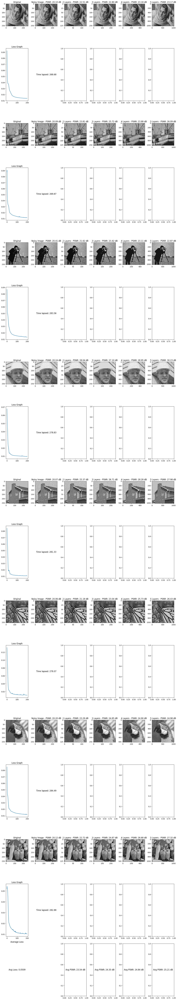

In [9]:
# This code block involves the image processing and visualization code. I have the set up code here, (load images), the
# code to add a certain type of noise, and then code to show the various images and visualizations
# that are displayed in the subplot.

import torch

def save_figure_as_image(figure, filename):
    figure.savefig(filename)

image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]


def evaluate_psnr(clean_image, noisy_image, denoised_image):
    # Resize denoised image to match clean_image
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')      # Convert to grayscale
        images.append(np.array(img, dtype=np.float32) / 255.0)  # Normalize to [0, 1]
    return images


images = load_images(image_paths)

def add_multiplicative_noise(image, noise_std):
  noise=np.random.normal(scale=1, size=image.shape)
  noisy_image =(image)*(noise)
  return noisy_image

def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

def process_image(clean_image_np, noise_std):
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    return noisy_image

fig, axs = plt.subplots(len(images) * 2 + 1, 6, figsize=(15, 5 * (len(images) * 2 + 1)))

def calculate_psnr_noisy(clean_image, noisy_image):
    mse = np.mean((clean_image - noisy_image) ** 2)
    max_pixel = 1
    psnr = 10 * np.log10((max_pixel ** 2) / mse)
    return psnr

for i, clean_image_np in enumerate(images):
    # Row 1: Denoised images for all layers
    axs[i * 2, 0].imshow(clean_image_np, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 0].set_title('Original')

    noise_std = 0.1
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    axs[i * 2, 1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 1].set_title(f'Noisy Image - PSNR: {calculate_psnr_noisy(clean_image_np, noisy_image):.2f} dB')

    for layers in range(2, 6):  # Change condition from layers < 5 to layers <= 5
        model_output, loss_history, time_elapsed = project_DIP(noisy_image, layers)
        psnr_noisy_additive, psnr_denoised_additive = evaluate_psnr(clean_image_np, noisy_image, model_output)
        axs[i * 2, layers].imshow(model_output, cmap='gray', vmin=0, vmax=1)
        axs[i * 2, layers].set_title(f'{layers} Layers - PSNR: {psnr_denoised_additive:.2f} dB')

    # Row 2: Plot PSNR, loss, and time taken
    axs[i * 2 + 1, 0].plot(loss_history)
    axs[i * 2 + 1, 0].set_title('Loss Graph')
    axs[i * 2 + 1, 1].text(0.5, 0.5, f'Time lapsed: {time_elapsed:.2f}', horizontalalignment='center', verticalalignment='center', fontsize=12)
    axs[i * 2 + 1, 1].axis('off')

# Calculate total average PSNR per layer and average convergence loss
avg_psnr_per_layer = [0] * 4
avg_loss = 0

for i, clean_image_np in enumerate(images):
    noise_std = 0.1
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    for layers in range(2, 6):
        model_output, loss_history, time_elapsed = project_DIP(noisy_image, layers)
        psnr_noisy_additive, psnr_denoised_additive = evaluate_psnr(clean_image_np, noisy_image, model_output)
        avg_psnr_per_layer[layers - 2] += psnr_denoised_additive
        avg_loss += loss_history[-1]

avg_psnr_per_layer = [x / len(images) for x in avg_psnr_per_layer]
avg_loss /= len(images)

# Display total average PSNR per layer and average convergence loss
for i, psnr in enumerate(avg_psnr_per_layer):
    axs[len(images) * 2, i + 2].text(0.5, 0.5, f'Avg PSNR: {psnr:.2f} dB', horizontalalignment='center', verticalalignment='center', fontsize=12)
axs[len(images) * 2, 0].axis('off')
axs[len(images) * 2, 1].axis('off')
axs[len(images) * 2, 0].set_title('Average Loss')
axs[len(images) * 2, 0].text(0.5, 0.5, f'Avg Loss: {avg_loss:.4f}', horizontalalignment='center', verticalalignment='center', fontsize=12)

plt.tight_layout()
plt.show()




---


**Explanation of the code:**

In the code above, the we take a series of images, and adds additive noise to these images.Then, we put these noisy images through our project_dip function, which preps the tensors to go through the dip model, to denoise the image.

In this section specifically, we test the effect of having different layers in the model, and the impact of these in potentially improving the psnr.

---


**Analysis of the results:**

Generally, we see that the PSNR reconstruction range is between 23.54-25.21 as average over layers 2-5. Looking at the average PSNR, the best image recontruction is at higher layers, such as when the model goes through 5 upsampling layers. There is quite a bit of improvement that happens between layer 4 to 5, however, a potential tradeoff to consider is the time that it takes to apply more layers of upsampling through model dip code because generally, the more layers, the more time it takes.

# Testing Multiplicative Noise

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.13723056018352509
Step 10, Loss: 0.10005650669336319
Step 20, Loss: 0.09868980199098587
Step 30, Loss: 0.09558292478322983
Step 40, Loss: 0.09361528605222702
Step 50, Loss: 0.09181072562932968
Step 60, Loss: 0.09040055423974991
Step 70, Loss: 0.08945377171039581
Step 80, Loss: 0.08888964354991913
Step 90, Loss: 0.08847551047801971
Step 100, Loss: 0.08814974129199982
Step 110, Loss: 0.087880440056324
Step 120, Loss: 0.08765245974063873
Step 130, Loss: 0.08745486289262772
Step 140, Loss: 0.0872790738940239
Step 150, Loss: 0.08711449056863785
Step 160, Loss: 0.08695681393146515
Step 170, Loss: 0.08680446445941925
Step 180, Loss: 0.08665916323661804
Step 190, Loss: 0.08652501553297043
Time lapsed 3.9455597400665283
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11196795850992203
Step 10, Loss: 0.09404613822698593
Step 20, Loss: 0.09048584848642349
Step 30, Loss: 0.08902524411678314
Step 40, Loss: 0.088217489

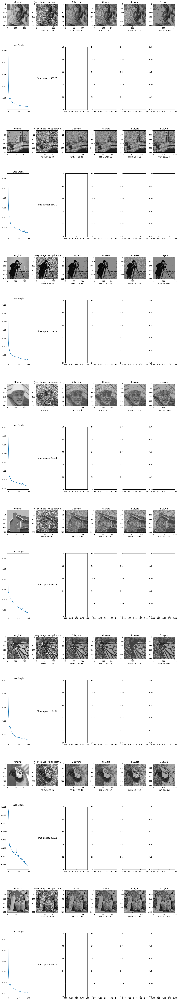

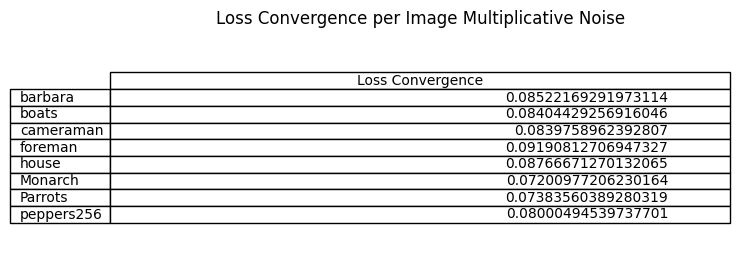

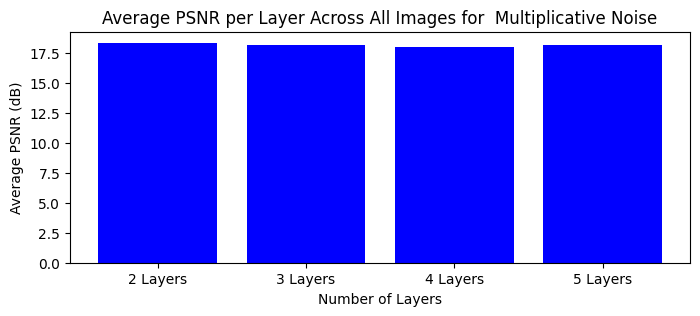

Average PSNR for 2 Layers: 18.37 dB
Average PSNR for 3 Layers: 18.14 dB
Average PSNR for 4 Layers: 18.00 dB
Average PSNR for 5 Layers: 18.18 dB


In [27]:
# Similarily to above, this code block involves the image processing and visualization code. I have the set up code here, (load images), the
# code to add a certain type of noise(and in this case, instead of additive - multiplicative noise here), and then code to show the various images and visualizations
# that are displayed in the subplot.

import os
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2
import math

import time

def save_figure_as_image(figure, filename):
    figure.savefig(filename)

def evaluate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images

def add_multiplicative_noise(image, noise_std):
    noise = np.random.normal(scale=1, size=image.shape)
    noisy_image = (image) * (noise)
    return noisy_image

# Load images
image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]

images = load_images(image_paths)

fig, axs = plt.subplots(len(images) * 2 , 6, figsize=(15, 5 * (len(images) * 2 + 1)))

best_psnr_per_image = []
psnr_values_per_layer = [[] for _ in range(4)]

loss_table_data = []

for i, clean_image_np in enumerate(images):
    axs[i * 2, 0].imshow(clean_image_np, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 0].set_title('Original')

    noise_std = 0.1
    noisy_image = add_multiplicative_noise(clean_image_np, noise_std)
    noisy_image = np.abs(np.sqrt(math.pi/2) * noisy_image)
    noisy_image = np.clip(noisy_image, 0, 1)
    axs[i * 2, 1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 1].set_title('Noisy Image  Multiplicative')
    psnr_noisy, _ = evaluate_psnr(clean_image_np, noisy_image, noisy_image)
    axs[i * 2, 1].text(0.5, -0.2, f'PSNR: {psnr_noisy:.2f} dB', horizontalalignment='center', verticalalignment='center', transform=axs[i * 2, 1].transAxes, fontsize=10)

    for layers in range(2, 6):
        model_output, loss_history, time_elapsed = project_DIP(noisy_image, layers)
        psnr_noisy_multiplicative, psnr_denoised_multiplicative = evaluate_psnr(clean_image_np, noisy_image, model_output)
        axs[i * 2, layers].imshow(model_output, cmap='gray', vmin=0, vmax=1)
        axs[i * 2, layers].set_title(f'{layers} Layers')

        axs[i * 2, layers].text(0.5, -0.2, f'PSNR: {psnr_denoised_multiplicative:.2f} dB',
                                horizontalalignment='center', verticalalignment='center',
                                transform=axs[i * 2, layers].transAxes, fontsize=10)

        psnr_values_per_layer[layers - 2].append(psnr_denoised_multiplicative)

    axs[i * 2 + 1, 0].plot(loss_history)
    axs[i * 2 + 1, 0].set_title('Loss Graph')

    axs[i * 2 + 1, 1].text(0.5, 0.5, f'Time lapsed: {time_elapsed:.2f}', horizontalalignment='center', verticalalignment='center', fontsize=12)
    axs[i * 2 + 1, 1].axis('off')

    if psnr_values_per_layer[-1]:
        best_psnr = max(psnr_values_per_layer[-1])
        best_psnr_per_image.append(best_psnr)
    else:
        best_psnr_per_image.append(0)

    loss_table_data.append(loss_history[-1])

plt.subplots_adjust(hspace=0.5)

plt.tight_layout()
plt.show()

loss_table_data = np.array(loss_table_data).reshape((len(images), 1))
table_columns = ['Loss Convergence']
table_rows = [os.path.splitext(os.path.basename(path))[0] for path in image_paths]
plt.figure(figsize=(8, 3))
plt.axis('off')
plt.table(cellText=loss_table_data, colLabels=table_columns, rowLabels=table_rows, loc='center')
plt.title('Loss Convergence per Image Multiplicative Noise')
plt.show()

average_psnr_per_layer = [np.mean(layer_psnr) if layer_psnr else 0 for layer_psnr in psnr_values_per_layer]

fig, ax = plt.subplots(figsize=(8, 3))
ax.bar(range(2, 6), average_psnr_per_layer, color='blue')
ax.set_xlabel('Number of Layers')
ax.set_ylabel('Average PSNR (dB)')
ax.set_title('Average PSNR per Layer Across All Images for  Multiplicative Noise')
ax.set_xticks(range(2, 6))
ax.set_xticklabels([f'{i} Layers' for i in range(2, 6)])
plt.show()

for idx, psnr in enumerate(average_psnr_per_layer, start=2):
    print(f'Average PSNR for {idx} Layers: {psnr:.2f} dB')




---


**Explanation of the code:**

In the code above, the we take a series of images, and adds multiplcative noise to these images. There is normalization that happens in this proces, to ensure that the intensity are within the range of [0,1], and the image is also multiplied by a factor of pi/2, which seems to be an opminal constant for multiplicative image denoising. This factor of pi/2 is derived from the noise standard deviation. And then the clipping in range of [0,1] helps ensure that the pixels remain valid.

Then, we put these noisy images through our project_dip function, which preps the tensors to go through the dip model, to denoise the image.

In this section specifically, we test the effect of having different layers in the model, and the impact of these in potentially improving the psnr.

---


**Analysis of the results:**

Generally, we see that the PSNR for multiplicative noise denoising is worse than additive noise. However, even then, it seems that the average PSNR is better at lower levels, rather than higher levels. Meaning, 2-3 layers do a better job of image reconstruction than higher layers.

# 256 vs 512 Image Size Multiplicative


32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14562541246414185


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([256, 256])) that is different to the input size (torch.Size([1, 1, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 10, Loss: 0.09576166421175003
Step 20, Loss: 0.09410721063613892
Step 30, Loss: 0.0905485525727272
Step 40, Loss: 0.08837650716304779
Step 50, Loss: 0.08620306849479675
Step 60, Loss: 0.08471811562776566
Step 70, Loss: 0.08388984948396683
Step 80, Loss: 0.08309438824653625
Step 90, Loss: 0.08245004713535309
Step 100, Loss: 0.0816882997751236
Step 110, Loss: 0.08112887293100357
Step 120, Loss: 0.08068008720874786
Step 130, Loss: 0.08026314526796341
Step 140, Loss: 0.07981021702289581
Step 150, Loss: 0.0794389620423317
Step 160, Loss: 0.07906792312860489
Step 170, Loss: 0.07894498109817505
Step 180, Loss: 0.07852935791015625
Step 190, Loss: 0.07808681577444077
Time lapsed 14.88354229927063
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14789870381355286
Step 10, Loss: 0.09847396612167358
Step 20, Loss: 0.09707365930080414
Step 30, Loss: 0.0935387909412384
Step 40, Loss: 0.0926617681980133
Step 50, Loss: 0.0919792503118515
Step 60, Loss: 0.09141499549150467
Step 70,

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([580, 720])) that is different to the input size (torch.Size([1, 1, 580, 720])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 0, Loss: 0.1539701372385025
Step 10, Loss: 0.09643298387527466
Step 20, Loss: 0.08806934952735901
Step 30, Loss: 0.08105013519525528
Step 40, Loss: 0.0793427973985672
Step 50, Loss: 0.0781487375497818
Step 60, Loss: 0.07757803052663803
Step 70, Loss: 0.07713956385850906
Step 80, Loss: 0.0768359899520874
Step 90, Loss: 0.07657682150602341
Step 100, Loss: 0.07634173333644867
Step 110, Loss: 0.07617132365703583
Step 120, Loss: 0.07599209249019623
Step 130, Loss: 0.07584608346223831
Step 140, Loss: 0.0756443664431572
Step 150, Loss: 0.07555066794157028
Step 160, Loss: 0.07536604255437851
Step 170, Loss: 0.0761917307972908
Step 180, Loss: 0.07540526241064072
Step 190, Loss: 0.07511008530855179
Time lapsed 82.85100293159485
64
input_tensor_size torch.Size([1, 64, 64, 64])


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([512, 512])) that is different to the input size (torch.Size([1, 1, 512, 512])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 0, Loss: 0.1668117195367813
Step 10, Loss: 0.10095744580030441
Step 20, Loss: 0.09907481074333191
Step 30, Loss: 0.09281141310930252
Step 40, Loss: 0.09178097546100616
Step 50, Loss: 0.09070899337530136
Step 60, Loss: 0.09019836783409119
Step 70, Loss: 0.089828260242939
Step 80, Loss: 0.08953429758548737
Step 90, Loss: 0.08929527550935745
Step 100, Loss: 0.08909682929515839
Step 110, Loss: 0.08892352879047394
Step 120, Loss: 0.08875754475593567
Step 130, Loss: 0.08858954161405563
Step 140, Loss: 0.08843038231134415
Step 150, Loss: 0.08828359842300415
Step 160, Loss: 0.08814632147550583
Step 170, Loss: 0.08801235258579254
Step 180, Loss: 0.08787702769041061
Step 190, Loss: 0.08775486052036285
Time lapsed 61.95558142662048
64
input_tensor_size torch.Size([1, 64, 64, 64])
Step 0, Loss: 0.13459694385528564
Step 10, Loss: 0.10163868218660355
Step 20, Loss: 0.08674558997154236
Step 30, Loss: 0.08470366150140762
Step 40, Loss: 0.08364524692296982
Step 50, Loss: 0.08306623995304108
Step 6

<Figure size 1200x800 with 0 Axes>

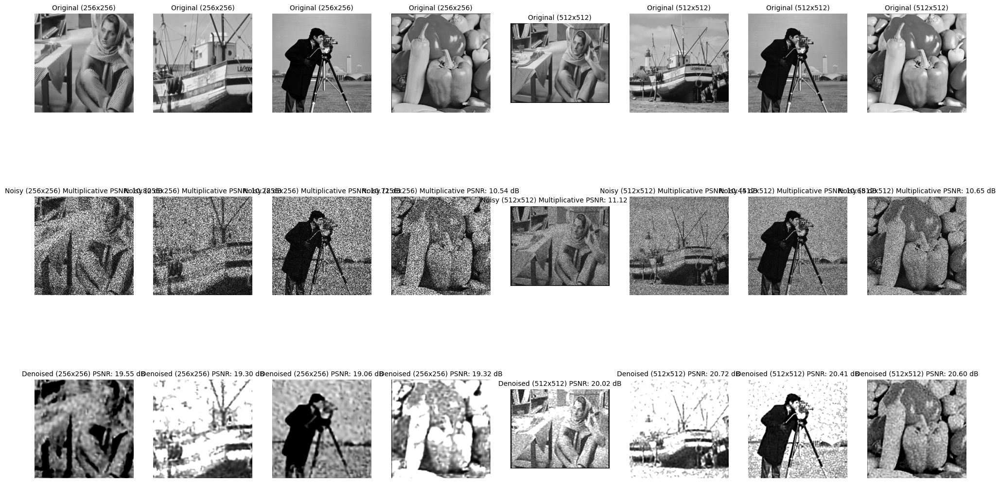

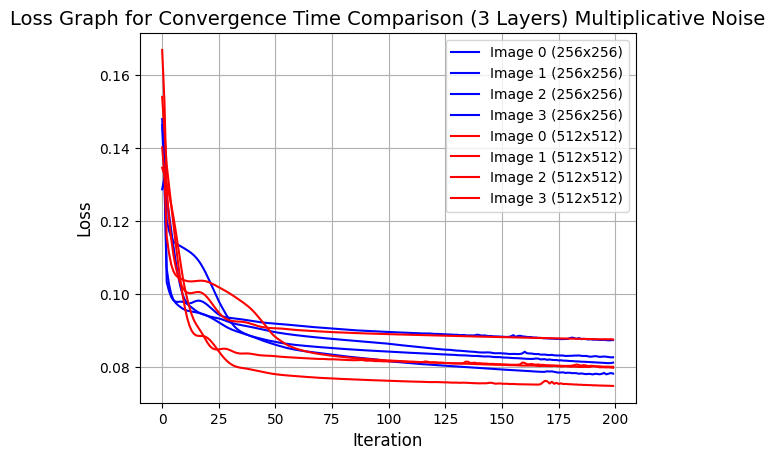

In [15]:
import math
import time
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image

def calculate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def resize_image(image, target_shape):
    return cv2.resize(image, target_shape, interpolation=cv2.INTER_LINEAR)

def add_multiplicative_noise(image, noise_std):
  noise=np.random.normal(scale=1, size=image.shape)
  noisy_image =(image)*(noise)
  return noisy_image

def calculate_psnr_noisy(clean_image, noisy_image):
    mse = np.mean((clean_image - noisy_image) ** 2)
    max_pixel = 1
    psnr = 10 * np.log10((max_pixel ** 2) / mse)
    return psnr

def test_denoising(images, image_paths):
    time_taken = []
    loss_history_list = []
    psnr_values = []
    noisy_images = []
    denoised_images = []

    for i, clean_image_np in enumerate(images):
        noise_std=0.1
        noisy_image = add_multiplicative_noise(clean_image_np, noise_std)
        noisy_image = np.abs(np.sqrt(math.pi / 2) * noisy_image)
        noisy_image = np.clip(noisy_image, 0, 1)
        noisy_images.append(noisy_image)

        start_time = time.time()
        model_output, loss_history, _ = project_DIP(noisy_image, 3)
        end_time = time.time()
        time_taken.append(end_time - start_time)
        loss_history_list.append(loss_history)

        denoised_image_resized = resize_image(model_output, clean_image_np.shape[::-1])
        denoised_images.append(denoised_image_resized)

        psnr = calculate_psnr(clean_image_np, noisy_image, model_output)
        psnr_values.append(psnr)

    return time_taken, loss_history_list, psnr_values, noisy_images, denoised_images

image_paths_256 = [
    'barbara256.png', 'boats.tif', 'cameraman.tif', 'peppers256.tif'
]

image_paths_512 = [
    'barbara512.gif', 'boats512.tif', 'test.jpeg', 'peppers512.tif'
]


def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images
images_256 = load_images(image_paths_256)

time_taken_256, loss_history_list_256, psnr_values_256, noisy_images_256, denoised_images_256 = test_denoising(images_256, image_paths_256)

images_512 = load_images(image_paths_512)
time_taken_512, loss_history_list_512, psnr_values_512, noisy_images_512, denoised_images_512 = test_denoising(images_512, image_paths_512)

import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))

total_columns = max(len(images_256), len(images_512)) * 3
plt.figure(figsize=(20, 16))  # Adjust the figure size to fit all subplots comfortably
total_images = len(images_256) + len(images_512)
cols_per_image_set = 3  # 'Original', 'Noisy', 'Denoised'

# Plot all images for 256x256 resolution
for i in range(len(images_256)):
    plt.subplot(4, total_images, i + 1)
    plt.imshow(images_256[i], cmap='gray')
    plt.title('Original (256x256)', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, total_images + i + 1)
    plt.imshow(noisy_images_256[i], cmap='gray')
    plt.title(f'Noisy (256x256) Multiplicative PSNR: {calculate_psnr_noisy(images_256[i], noisy_images_256[i]):.2f} dB', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, 2 * total_images + i + 1)
    plt.imshow(denoised_images_256[i], cmap='gray')
    plt.title(f'Denoised (256x256) PSNR: {psnr_values_256[i][1]:.2f} dB', fontsize=10)
    plt.axis('off')

# Plot all images for 512x512 resolution
for j in range(len(images_512)):
    idx = len(images_256) + j
    plt.subplot(4, total_images, idx + 1)
    plt.imshow(images_512[j], cmap='gray')
    plt.title('Original (512x512)', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, total_images + idx + 1)
    plt.imshow(noisy_images_512[j], cmap='gray')
    plt.title(f'Noisy (512x512) Multiplicative PSNR: {calculate_psnr_noisy(images_512[j], noisy_images_512[j]):.2f} dB', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, 2 * total_images + idx + 1)
    plt.imshow(denoised_images_512[j], cmap='gray')
    plt.title(f'Denoised (512x512) PSNR: {psnr_values_512[j][1]:.2f} dB', fontsize=10)
    plt.axis('off')

plt.tight_layout(pad=3.0)  # Increase padding to prevent overlap of subplot titles and images
plt.show()

plt.figure(figsize=(15, 6))
for i, loss_history_256 in enumerate(loss_history_list_256):
    plt.plot(loss_history_256, label=f'Image {i} (256x256)', color='blue')
for i, loss_history_512 in enumerate(loss_history_list_512):
    plt.plot(loss_history_512, label=f'Image {i} (512x512)', color='red')

plt.xlabel('Iteration', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss Graph for Convergence Time Comparison (3 Layers) Multiplicative Noise', fontsize=14)
plt.legend()
plt.grid(True)
plt.show()




---


**Explanation of the code:**

In the code above, I test the effect of image size, on the image reconstruction PSNR. Specifcially, in this code block, I'm putting a series of images that I could find a 256 and 512 pixel size version of, and comapring their denoised performance after adding multiplicative noise to the original clean image versions.

---


**Analysis of the results:**
For the 4 images that we compared, it's consistently seen that the 512x512 images have a better denoising than the 256x256 images. This can also be seen in the loss graph with the red lines represetning 512x512 images, and blue lines representing 256x256 images. Here, although the red lines, 512x512, start of at a higher loss, they have a lower loss than the 256x256 images by the time the loss graph starts to converge.

# 256 vs 512 Image Size Additive

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.12356164306402206


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([256, 256])) that is different to the input size (torch.Size([1, 1, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 10, Loss: 0.03520039841532707
Step 20, Loss: 0.03131238743662834
Step 30, Loss: 0.022567085921764374
Step 40, Loss: 0.019992437213659286
Step 50, Loss: 0.018066368997097015
Step 60, Loss: 0.017098957672715187
Step 70, Loss: 0.016373181715607643
Step 80, Loss: 0.015749596059322357
Step 90, Loss: 0.015266438014805317
Step 100, Loss: 0.01488661952316761
Step 110, Loss: 0.01457273494452238
Step 120, Loss: 0.014301103539764881
Step 130, Loss: 0.014068325981497765
Step 140, Loss: 0.013864154927432537
Step 150, Loss: 0.013700177893042564
Step 160, Loss: 0.013542264699935913
Step 170, Loss: 0.013398492708802223
Step 180, Loss: 0.01329846866428852
Step 190, Loss: 0.013180028647184372
Time lapsed 16.32300877571106
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.10067453980445862
Step 10, Loss: 0.03291201964020729
Step 20, Loss: 0.02112065628170967
Step 30, Loss: 0.015248195268213749
Step 40, Loss: 0.013461234979331493
Step 50, Loss: 0.01255701668560505
Step 60, Loss: 0.0120

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([580, 720])) that is different to the input size (torch.Size([1, 1, 580, 720])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 0, Loss: 0.12046515941619873
Step 10, Loss: 0.04055418819189072
Step 20, Loss: 0.029623692855238914
Step 30, Loss: 0.022668382152915
Step 40, Loss: 0.019076047465205193
Step 50, Loss: 0.017540346831083298
Step 60, Loss: 0.016714412719011307
Step 70, Loss: 0.016251031309366226
Step 80, Loss: 0.016048390418291092
Step 90, Loss: 0.015770118683576584
Step 100, Loss: 0.015589278191328049
Step 110, Loss: 0.015426594763994217
Step 120, Loss: 0.01530244667083025
Step 130, Loss: 0.015196462161839008
Step 140, Loss: 0.015103737823665142
Step 150, Loss: 0.015050437301397324
Step 160, Loss: 0.01492408849298954
Step 170, Loss: 0.01484706811606884
Step 180, Loss: 0.014828948304057121
Step 190, Loss: 0.014786896295845509
Time lapsed 81.61276721954346
64
input_tensor_size torch.Size([1, 64, 64, 64])


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([512, 512])) that is different to the input size (torch.Size([1, 1, 512, 512])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Step 0, Loss: 0.06294118613004684
Step 10, Loss: 0.04118435084819794
Step 20, Loss: 0.03407365828752518
Step 30, Loss: 0.020942438393831253
Step 40, Loss: 0.01616050861775875
Step 50, Loss: 0.014979846775531769
Step 60, Loss: 0.014317612163722515
Step 70, Loss: 0.013899176381528378
Step 80, Loss: 0.013575049117207527
Step 90, Loss: 0.013291868381202221
Step 100, Loss: 0.013035044074058533
Step 110, Loss: 0.012800998985767365
Step 120, Loss: 0.012592035345733166
Step 130, Loss: 0.012393366545438766
Step 140, Loss: 0.012220718897879124
Step 150, Loss: 0.012169746682047844
Step 160, Loss: 0.011897486634552479
Step 170, Loss: 0.011771708726882935
Step 180, Loss: 0.011687851510941982
Step 190, Loss: 0.011610154062509537
Time lapsed 65.42157769203186
64
input_tensor_size torch.Size([1, 64, 64, 64])
Step 0, Loss: 0.08927907049655914
Step 10, Loss: 0.04006962850689888
Step 20, Loss: 0.024332931265234947
Step 30, Loss: 0.01988844946026802
Step 40, Loss: 0.018085509538650513
Step 50, Loss: 0.016

<Figure size 1500x1000 with 0 Axes>

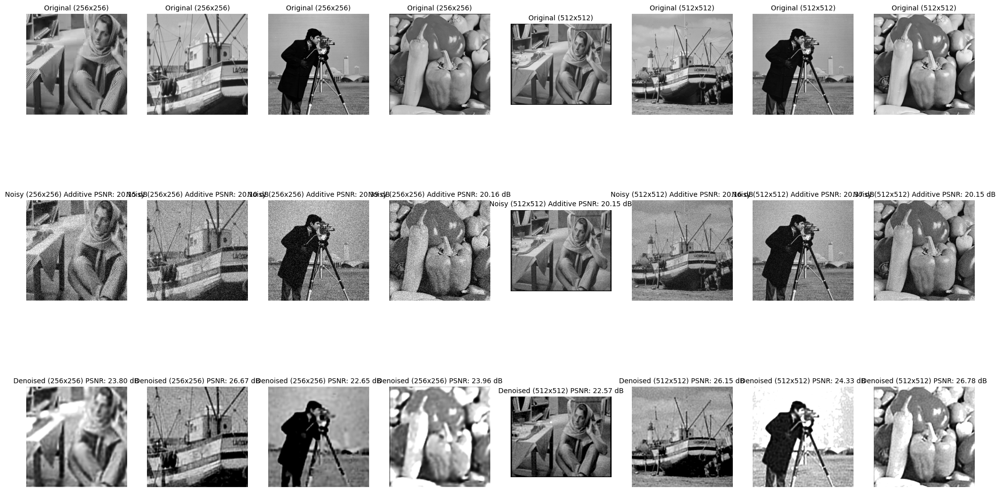

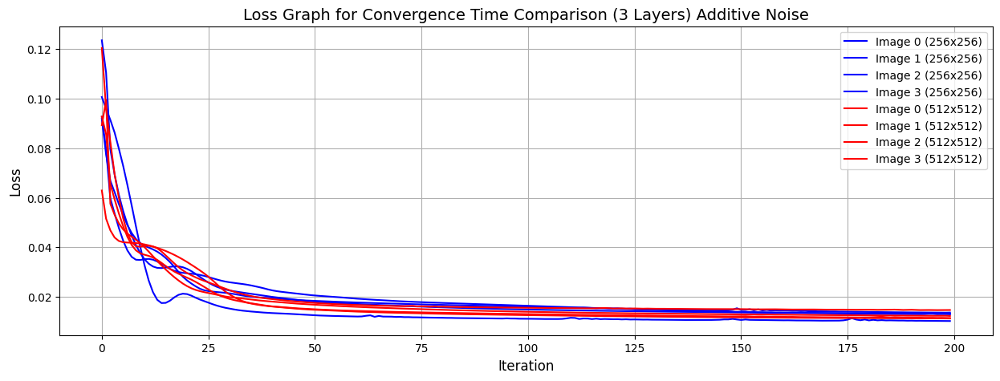

In [17]:
import math
import time
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image

def calculate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def resize_image(image, target_shape):
    return cv2.resize(image, target_shape, interpolation=cv2.INTER_LINEAR)

def calculate_psnr_noisy(clean_image, noisy_image):
    mse = np.mean((clean_image - noisy_image) ** 2)
    max_pixel = 1
    psnr = 10 * np.log10((max_pixel ** 2) / mse)
    return psnr


def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

def test_denoising(images, image_paths):
    time_taken = []
    loss_history_list = []
    psnr_values = []
    noisy_images = []
    denoised_images = []

    for i, clean_image_np in enumerate(images):
        noise_std=0.1
        noisy_image = add_additive_noise(clean_image_np, noise_std)

        noisy_images.append(noisy_image)

        start_time = time.time()
        model_output, loss_history, _ = project_DIP(noisy_image, 3)
        end_time = time.time()
        time_taken.append(end_time - start_time)
        loss_history_list.append(loss_history)

        denoised_image_resized = resize_image(model_output, clean_image_np.shape[::-1])
        denoised_images.append(denoised_image_resized)

        psnr = calculate_psnr(clean_image_np, noisy_image, model_output)
        psnr_values.append(psnr)

    return time_taken, loss_history_list, psnr_values, noisy_images, denoised_images

image_paths_256 = [
    'barbara256.png', 'boats.tif', 'cameraman.tif', 'peppers256.tif'
]

image_paths_512 = [
    'barbara512.gif', 'boats512.tif', 'test.jpeg', 'peppers512.tif'
]

images_256 = load_images(image_paths_256)
time_taken_256, loss_history_list_256, psnr_values_256, noisy_images_256, denoised_images_256 = test_denoising(images_256, image_paths_256)

images_512 = load_images(image_paths_512)
time_taken_512, loss_history_list_512, psnr_values_512, noisy_images_512, denoised_images_512 = test_denoising(images_512, image_paths_512)


import matplotlib.pyplot as plt


plt.figure(figsize=(15, 10))

total_columns = max(len(images_256), len(images_512)) * 3
plt.figure(figsize=(20, 16))  # Adjust the figure size to fit all subplots comfortably
total_images = len(images_256) + len(images_512)
cols_per_image_set = 3  # 'Original', 'Noisy', 'Denoised'

# Plot all images for 256x256 resolution
for i in range(len(images_256)):
    plt.subplot(4, total_images, i + 1)
    plt.imshow(images_256[i], cmap='gray')
    plt.title('Original (256x256)', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, total_images + i + 1)
    plt.imshow(noisy_images_256[i], cmap='gray')
    plt.title(f'Noisy (256x256) Additive PSNR: {calculate_psnr_noisy(images_256[i], noisy_images_256[i]):.2f} dB', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, 2 * total_images + i + 1)
    plt.imshow(denoised_images_256[i], cmap='gray')
    plt.title(f'Denoised (256x256) PSNR: {psnr_values_256[i][1]:.2f} dB', fontsize=10)
    plt.axis('off')

# Plot all images for 512x512 resolution
for j in range(len(images_512)):
    idx = len(images_256) + j
    plt.subplot(4, total_images, idx + 1)
    plt.imshow(images_512[j], cmap='gray')
    plt.title('Original (512x512)', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, total_images + idx + 1)
    plt.imshow(noisy_images_512[j], cmap='gray')
    plt.title(f'Noisy (512x512) Additive PSNR: {calculate_psnr_noisy(images_512[j], noisy_images_512[j]):.2f} dB', fontsize=10)
    plt.axis('off')

    plt.subplot(4, total_images, 2 * total_images + idx + 1)
    plt.imshow(denoised_images_512[j], cmap='gray')
    plt.title(f'Denoised (512x512) PSNR: {psnr_values_512[j][1]:.2f} dB', fontsize=10)
    plt.axis('off')

plt.tight_layout(pad=3.0)  # Increase padding to prevent overlap of subplot titles and images
plt.show()


plt.figure(figsize=(15, 5))

for i, loss_history_256 in enumerate(loss_history_list_256):
    plt.plot(loss_history_256, label=f'Image {i} (256x256)', color='blue')
for i, loss_history_512 in enumerate(loss_history_list_512):
    plt.plot(loss_history_512, label=f'Image {i} (512x512)', color='red')

plt.xlabel('Iteration', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss Graph for Convergence Time Comparison (3 Layers) Additive Noise', fontsize=14)
plt.legend()
plt.grid(True)
plt.show()




---


**Explanation of the code:**

In the code above, I test the effect of image size, on the image reconstruction PSNR. Specifcially, in this code block, I'm putting a series of images that I could find a 256 and 512 pixel size version of, and comapring their denoised performance after adding additive noise to the original clean image versions.

---


**Analysis of the results:**
For the 4 images that we compared, it's consistently seen that the 512x512 images have a better denoising than the 256x256 images. This can also be seen in the loss graph with the red lines represetning 512x512 images, and blue lines representing 256x256 images. Here, although the red lines, 512x512, start of at a higher loss, they have a lower loss than the 256x256 images by the time the loss graph starts to converge.

Compared the the loss graph for multiplicative noise, the loss graph doesn't have as large a gap between teh 256 vs 512 image sizes that inital iteration - however the general trend of 512 image sizes showing lower loss by the end remains the same.

# Kernel Size multiplicative


Time lapsed {kernel_size:.2f} 14.562555074691772
Time lapsed {kernel_size:.2f} 21.158555507659912
Time lapsed {kernel_size:.2f} 29.400826692581177
Time lapsed {kernel_size:.2f} 29.997895002365112
Time lapsed {kernel_size:.2f} 12.608290195465088
Time lapsed {kernel_size:.2f} 20.32284688949585
Time lapsed {kernel_size:.2f} 22.989243268966675
Time lapsed {kernel_size:.2f} 30.95868182182312
Time lapsed {kernel_size:.2f} 11.631480932235718
Time lapsed {kernel_size:.2f} 15.756237506866455
Time lapsed {kernel_size:.2f} 22.676469564437866
Time lapsed {kernel_size:.2f} 38.981900453567505
Time lapsed {kernel_size:.2f} 20.52408528327942
Time lapsed {kernel_size:.2f} 21.078774452209473
Time lapsed {kernel_size:.2f} 34.649540424346924
Time lapsed {kernel_size:.2f} 38.23346209526062
Time lapsed {kernel_size:.2f} 11.325273513793945
Time lapsed {kernel_size:.2f} 14.70531177520752
Time lapsed {kernel_size:.2f} 21.068467378616333
Time lapsed {kernel_size:.2f} 30.455767154693604
Time lapsed {kernel_size:

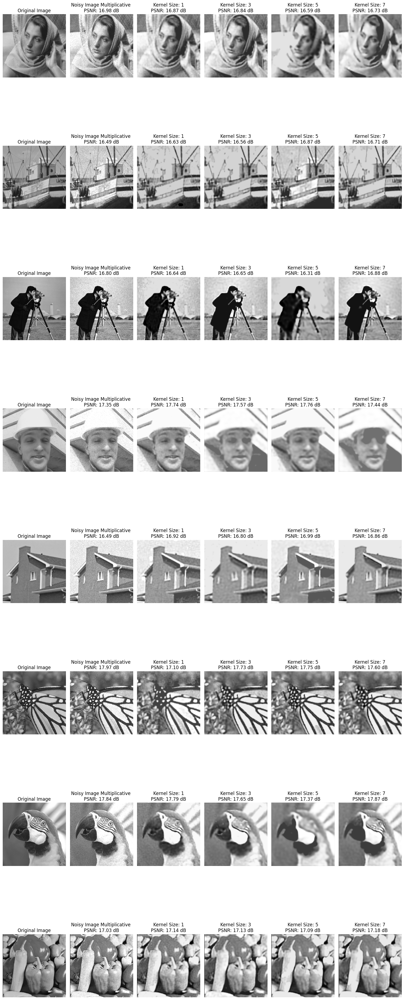

Average PSNRs by Kernel Size for Multiplicative Noise:
Kernel Size 1: 17.10 dB
Kernel Size 3: 17.12 dB
Kernel Size 5: 17.09 dB
Kernel Size 7: 17.16 dB


In [22]:
class model_dip_three_layers(nn.Module):
    def __init__(self, kernel_size=3):
        super(model_dip_three_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=kernel_size, padding=kernel_size // 2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=kernel_size, padding=kernel_size // 2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)
        x = self.up6(x)
        x = self.final(x)
        return x



def project_DIP_with_kernel(x_temp, layer, kernel_size):
    n1, n2 = x_temp.shape
    sizen1 = int(n1 / 8)
    input_tensor = torch.randn(1, 64, sizen1, sizen1)
    if not isinstance(x_temp, torch.Tensor):
        x_temp = torch.from_numpy(x_temp).float()

    if layer == 2:
        model = model_dip_two_layers(kernel_size=kernel_size)
    elif layer == 3:
        model = model_dip_three_layers(kernel_size=kernel_size)
    elif layer == 4:
        model = model_dip_four_layers(kernel_size=kernel_size)
    elif layer == 5:
        model = model_dip_five_layers(kernel_size=kernel_size)
    else:
        model = model_dip_three_layers(kernel_size=kernel_size)

    optimizer = optim.Adam(model.parameters(), lr=0.05)
    criterion = nn.MSELoss()

    loss_history = []
    start_time = time.time()
    num_steps = 200
    for step in range(num_steps):
        optimizer.zero_grad()
        output = model(input_tensor)

        output_resized = F.interpolate(output, size=x_temp.shape[-2:], mode='bilinear', align_corners=False)
        loss = criterion(output_resized, x_temp)
        loss_history.append(loss.item())

        loss.backward()
        optimizer.step()

        # if step % 10 == 0:
            # print(f"Step {step}, Loss: {loss.item()}")
    end_time = time.time()
    time_elapsed = end_time - start_time
    print("Time lapsed {kernel_size:.2f}", time_elapsed)

    output_np = output.squeeze().detach().numpy()

    return output_np, loss_history, time_elapsed

kernel_sizes = [1, 3, 5, 7]

psnr_results_kernel = {}

noise_std =0.1

def evaluate_psnr(true_image, test_image):
    mse = np.mean((true_image - test_image) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * np.log10(1.0 / np.sqrt(mse))

image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
     'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'

]

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images

images = load_images(image_paths)
psnr_results = {}

import matplotlib.pyplot as plt


import matplotlib.pyplot as plt
import numpy as np

def display_images_and_psnr(images, kernel_sizes, results):
    num_images = len(images)
    num_kernels = len(kernel_sizes)
    psnr_per_kernel = {k: [] for k in kernel_sizes}

    fig, axs = plt.subplots(num_images, 2 + num_kernels, figsize=(15, 5 * num_images))

    for i, image in enumerate(images):
        ax = axs[i, 0]
        ax.imshow(image, cmap='gray', vmin=0, vmax=1)
        ax.set_title('Original Image')
        ax.axis('off')

        noisy_image = add_multiplicative_noise(image, noise_std=0.1)
        noisy_image = np.abs(np.sqrt(math.pi / 2) * noisy_image)
        noisy_image = np.clip(noisy_image, 0, 1)
        psnr_noisy = evaluate_psnr(image, noisy_image)

        ax = axs[i, 1]
        ax.imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
        ax.set_title(f'Noisy Image Multiplicative \nPSNR: {psnr_noisy:.2f} dB')
        ax.axis('off')

        for j, kernel_size in enumerate(kernel_sizes):
            denoised_image, _, _ = project_DIP_with_kernel(noisy_image, layer=3, kernel_size=kernel_size)
            psnr_denoised = evaluate_psnr(image, denoised_image)
            psnr_per_kernel[kernel_size].append(psnr_denoised)

            ax = axs[i, j + 2]
            ax.imshow(denoised_image, cmap='gray', vmin=0, vmax=1)
            ax.set_title(f'Kernel Size: {kernel_size}\nPSNR: {psnr_denoised:.2f} dB')
            ax.axis('off')

    plt.tight_layout()
    plt.show()

    avg_psnrs = {k: np.mean(v) for k, v in psnr_per_kernel.items()}
    print("Average PSNRs by Kernel Size for Multiplicative Noise:")
    for kernel_size, avg_psnr in avg_psnrs.items():
        print(f"Kernel Size {kernel_size}: {avg_psnr:.2f} dB")

psnr_results = {}
for i, img_path in enumerate(image_paths):
    psnr_results[(img_path, "noisy")] = np.random.uniform(20, 30)  # Example PSNR for noisy image

display_images_and_psnr(images, kernel_sizes, psnr_results)




---


**Explanation of code block:**
In the code block above, we test the the impact of the kernel size, on the reconstruction of a series of images - given that we've added multiplicative noise to these images. The kernel size is a variable that's part of the model_dip_three_layers, model for the decoder. The kernel size is passed a parameter to the model_dip_three_layers class, which then, runs a series of convolution upsampling steps using the particular kernel size.


---


**Analysis of results:**

For multiplicative noise, results show that the reconstruction quality is best for kernel sizes that are higher. Analyzing the images individual as well, the image reconstruction quality is best at a kernel size of 7.

# kernel size additive

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([256, 256])) that is different to the input size (torch.Size([1, 1, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Time lapsed {kernel_size:.2f} 12.205913305282593
Time lapsed {kernel_size:.2f} 15.63352084159851
Time lapsed {kernel_size:.2f} 20.896517992019653
Time lapsed {kernel_size:.2f} 29.813048839569092
Time lapsed {kernel_size:.2f} 11.533783197402954
Time lapsed {kernel_size:.2f} 15.28990888595581
Time lapsed {kernel_size:.2f} 20.859194040298462
Time lapsed {kernel_size:.2f} 30.875013828277588
Time lapsed {kernel_size:.2f} 11.015872240066528
Time lapsed {kernel_size:.2f} 15.24247431755066
Time lapsed {kernel_size:.2f} 20.417839288711548
Time lapsed {kernel_size:.2f} 30.35924506187439
Time lapsed {kernel_size:.2f} 11.888136386871338
Time lapsed {kernel_size:.2f} 14.49205207824707
Time lapsed {kernel_size:.2f} 20.713526487350464
Time lapsed {kernel_size:.2f} 29.500686168670654
Time lapsed {kernel_size:.2f} 11.222581386566162
Time lapsed {kernel_size:.2f} 14.746794700622559
Time lapsed {kernel_size:.2f} 20.8400776386261
Time lapsed {kernel_size:.2f} 29.774153232574463
Time lapsed {kernel_size:.2

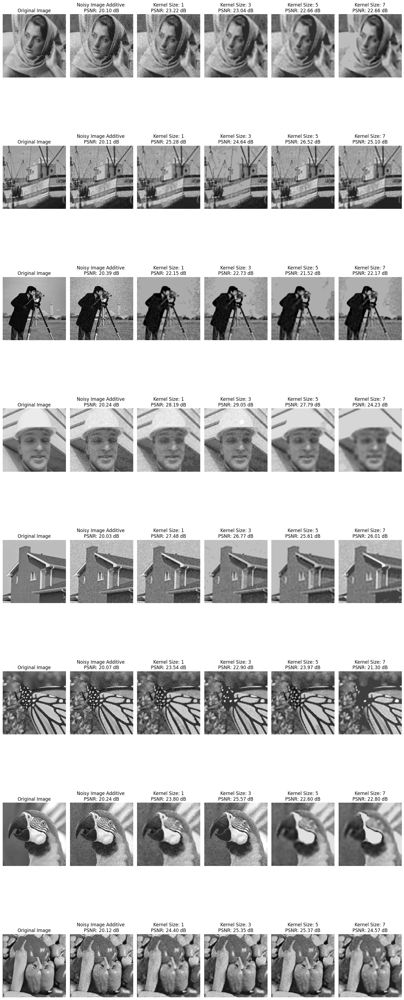

Average PSNRs by Kernel Size for Additive Noise:
Kernel Size 1: 24.76 dB
Kernel Size 3: 25.01 dB
Kernel Size 5: 24.51 dB
Kernel Size 7: 23.61 dB


In [23]:

def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

class model_dip_three_layers(nn.Module):
    def __init__(self, kernel_size=3):
        super(model_dip_three_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=kernel_size, padding=kernel_size // 2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=kernel_size, padding=kernel_size // 2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)
        x = self.up6(x)
        x = self.final(x)
        return x



def project_DIP_with_kernel(x_temp, layer, kernel_size):
    n1, n2 = x_temp.shape
    sizen1 = int(n1 / 8)
    input_tensor = torch.randn(1, 64, sizen1, sizen1)
    if not isinstance(x_temp, torch.Tensor):
        x_temp = torch.from_numpy(x_temp).float()

    if layer == 2:
        model = model_dip_two_layers(kernel_size=kernel_size)
    elif layer == 3:
        model = model_dip_three_layers(kernel_size=kernel_size)
    elif layer == 4:
        model = model_dip_four_layers(kernel_size=kernel_size)
    elif layer == 5:
        model = model_dip_five_layers(kernel_size=kernel_size)
    else:
        model = model_dip_three_layers(kernel_size=kernel_size)

    optimizer = optim.Adam(model.parameters(), lr=0.05)
    criterion = nn.MSELoss()

    loss_history = []
    start_time = time.time()
    num_steps = 200
    for step in range(num_steps):
        optimizer.zero_grad()
        output = model(input_tensor)

        output_resized = F.interpolate(output, size=x_temp.shape[-2:], mode='bilinear', align_corners=False)
        loss = criterion(output_resized, x_temp)
        loss_history.append(loss.item())

        loss.backward()
        optimizer.step()

        # if step % 10 == 0:
            # print(f"Step {step}, Loss: {loss.item()}")
    end_time = time.time()
    time_elapsed = end_time - start_time
    print("Time lapsed {kernel_size:.2f}", time_elapsed)

    output_np = output.squeeze().detach().numpy()

    return output_np, loss_history, time_elapsed

kernel_sizes = [1, 3, 5, 7]

psnr_results_kernel = {}

noise_std =0.1

def evaluate_psnr(true_image, test_image):
    mse = np.mean((true_image - test_image) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * np.log10(1.0 / np.sqrt(mse))

image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
     'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'

]

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images

images = load_images(image_paths)
psnr_results = {}

import matplotlib.pyplot as plt


import matplotlib.pyplot as plt
import numpy as np

def display_images_and_psnr(images, kernel_sizes, results):
    num_images = len(images)
    num_kernels = len(kernel_sizes)
    psnr_per_kernel = {k: [] for k in kernel_sizes}

    fig, axs = plt.subplots(num_images, 2 + num_kernels, figsize=(15, 5 * num_images))

    for i, image in enumerate(images):
        ax = axs[i, 0]
        ax.imshow(image, cmap='gray', vmin=0, vmax=1)
        ax.set_title('Original Image')
        ax.axis('off')

        noisy_image = add_additive_noise(image, noise_std=0.1)
        psnr_noisy = evaluate_psnr(image, noisy_image)

        ax = axs[i, 1]
        ax.imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
        ax.set_title(f'Noisy Image Additive \nPSNR: {psnr_noisy:.2f} dB')
        ax.axis('off')

        for j, kernel_size in enumerate(kernel_sizes):
            denoised_image, _, _ = project_DIP_with_kernel(noisy_image, layer=3, kernel_size=kernel_size)
            psnr_denoised = evaluate_psnr(image, denoised_image)
            psnr_per_kernel[kernel_size].append(psnr_denoised)

            ax = axs[i, j + 2]
            ax.imshow(denoised_image, cmap='gray', vmin=0, vmax=1)
            ax.set_title(f'Kernel Size: {kernel_size}\nPSNR: {psnr_denoised:.2f} dB')
            ax.axis('off')

    plt.tight_layout()
    plt.show()

    avg_psnrs = {k: np.mean(v) for k, v in psnr_per_kernel.items()}
    print("Average PSNRs by Kernel Size for Additive Noise:")
    for kernel_size, avg_psnr in avg_psnrs.items():
        print(f"Kernel Size {kernel_size}: {avg_psnr:.2f} dB")

psnr_results = {}
for i, img_path in enumerate(image_paths):
    psnr_results[(img_path, "noisy")] = np.random.uniform(20, 30)  # Example PSNR for noisy image

display_images_and_psnr(images, kernel_sizes, psnr_results)




---


**Explanation of code block:**

In the code block above, we test the the impact of the kernel size, on the reconstruction of a series of images - given that we've added additive noise to these images.



---


**Analysis of results:**
Looking at the average PSNR by kernel size for additive noise results in the very end of the results data above,it looks like a kernel size of 3 is optimal for the best reconstruction. This is interesting however, because certain images generally tend to have a better reconstruction than other at all kernel sizes. Therefore, analyzing on a case by case basic, it looks like for images such as the house, barbara, and boats - kernel size of 1 seems to do better. However, other set of images like parrot, foreman, cameraman, kernel 3 is better.


# Power of Noise


32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.054344989359378815
Step 10, Loss: 0.028887266293168068
Step 20, Loss: 0.02158108912408352
Step 30, Loss: 0.018500011414289474
Step 40, Loss: 0.01750124618411064
Step 50, Loss: 0.016797425225377083
Step 60, Loss: 0.016315145418047905
Step 70, Loss: 0.015911201015114784
Step 80, Loss: 0.015547258779406548
Step 90, Loss: 0.015266016125679016
Step 100, Loss: 0.015025850385427475
Step 110, Loss: 0.014818184077739716
Step 120, Loss: 0.014653332531452179
Step 130, Loss: 0.014539406634867191
Step 140, Loss: 0.014452651143074036
Step 150, Loss: 0.014354439452290535
Step 160, Loss: 0.014284207485616207
Step 170, Loss: 0.014209638349711895
Step 180, Loss: 0.014292746782302856
Step 190, Loss: 0.01409817859530449
Time lapsed 27.43822431564331
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1256866157054901
Step 10, Loss: 0.10041014850139618
Step 20, Loss: 0.09719524532556534
Step 30, Loss: 0.0943390354514122
Step 40, 

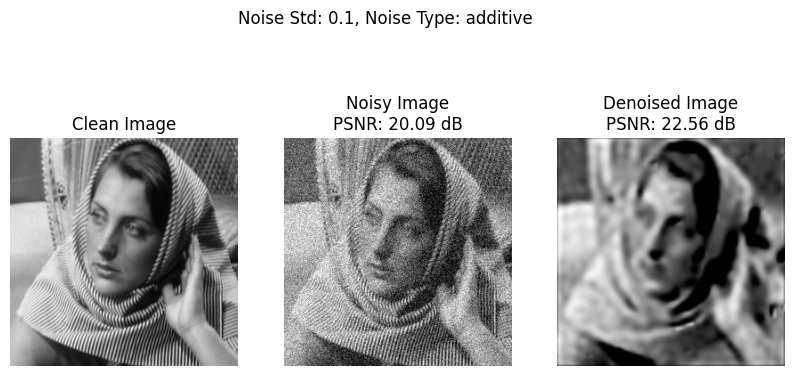

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11984468251466751
Step 10, Loss: 0.09950987994670868
Step 20, Loss: 0.0950702652335167
Step 30, Loss: 0.09130965173244476
Step 40, Loss: 0.08954164385795593
Step 50, Loss: 0.0886242464184761
Step 60, Loss: 0.08803130686283112
Step 70, Loss: 0.08754637092351913
Step 80, Loss: 0.08714251220226288
Step 90, Loss: 0.0867769792675972
Step 100, Loss: 0.0864553228020668
Step 110, Loss: 0.0861976146697998
Step 120, Loss: 0.08597397804260254
Step 130, Loss: 0.08570802211761475
Step 140, Loss: 0.08544613420963287
Step 150, Loss: 0.08508601784706116
Step 160, Loss: 0.08479398488998413
Step 170, Loss: 0.08455990254878998
Step 180, Loss: 0.08437996357679367
Step 190, Loss: 0.08412184566259384
Time lapsed 15.372396230697632


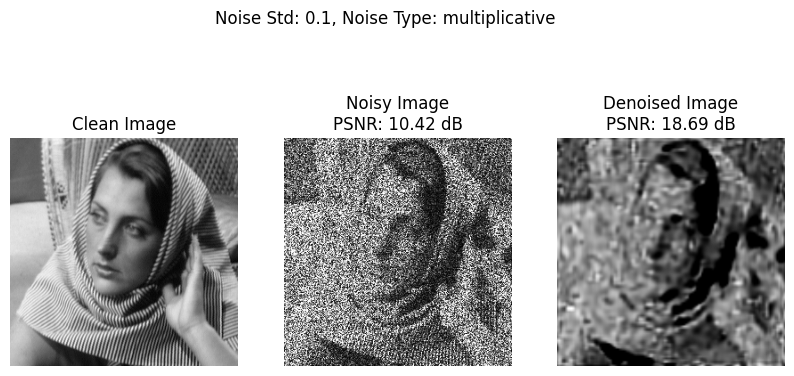

Image: barbara.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.46 dB, Average PSNR (Denoised): 20.37 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.12464819103479385
Step 10, Loss: 0.04939386248588562
Step 20, Loss: 0.04689270257949829
Step 30, Loss: 0.04236000403761864
Step 40, Loss: 0.0414503738284111
Step 50, Loss: 0.04097922518849373
Step 60, Loss: 0.04046466946601868
Step 70, Loss: 0.04000619053840637
Step 80, Loss: 0.0395827516913414
Step 90, Loss: 0.039187364280223846
Step 100, Loss: 0.03878917917609215
Step 110, Loss: 0.03846948593854904
Step 120, Loss: 0.03823725879192352
Step 130, Loss: 0.03801083192229271
Step 140, Loss: 0.0378449372947216
Step 150, Loss: 0.03762658312916756
Step 160, Loss: 0.037436388432979584
Step 170, Loss: 0.03734392672777176
Step 180, Loss: 0.037131182849407196
Step 190, Loss: 0.03718210384249687
Time lapsed 15.382522106170654


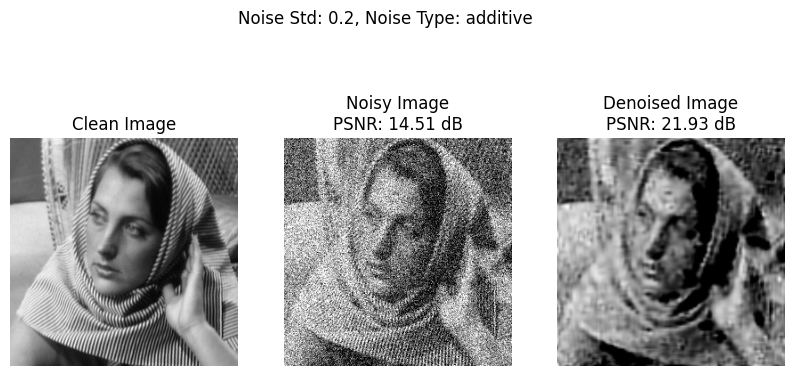

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11386816948652267
Step 10, Loss: 0.09529275447130203
Step 20, Loss: 0.09186945110559464
Step 30, Loss: 0.08997607976198196
Step 40, Loss: 0.0887984186410904
Step 50, Loss: 0.088139109313488
Step 60, Loss: 0.08762052655220032
Step 70, Loss: 0.08717654645442963
Step 80, Loss: 0.08675308525562286
Step 90, Loss: 0.08636929094791412
Step 100, Loss: 0.08599669486284256
Step 110, Loss: 0.08567845076322556
Step 120, Loss: 0.0853588804602623
Step 130, Loss: 0.08516612648963928
Step 140, Loss: 0.08482056856155396
Step 150, Loss: 0.08457440882921219
Step 160, Loss: 0.08438092470169067
Step 170, Loss: 0.08403442800045013
Step 180, Loss: 0.08398861438035965
Step 190, Loss: 0.08377520740032196
Time lapsed 16.315101146697998


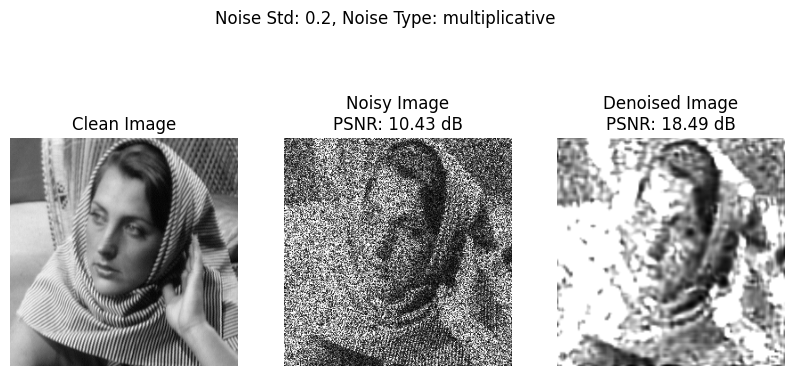

Image: barbara.tif, Noise Std: 0.3
Average PSNR (Noisy): 11.08 dB, Average PSNR (Denoised): 19.54 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1262897402048111
Step 10, Loss: 0.08725770562887192
Step 20, Loss: 0.08400579541921616
Step 30, Loss: 0.07913541048765182
Step 40, Loss: 0.07594874501228333
Step 50, Loss: 0.07434339076280594
Step 60, Loss: 0.07339631766080856
Step 70, Loss: 0.07273411005735397
Step 80, Loss: 0.07223609834909439
Step 90, Loss: 0.07188085466623306
Step 100, Loss: 0.07158675044775009
Step 110, Loss: 0.07133892923593521
Step 120, Loss: 0.07110656797885895
Step 130, Loss: 0.07087574154138565
Step 140, Loss: 0.07064899057149887
Step 150, Loss: 0.07043144106864929
Step 160, Loss: 0.07021601498126984
Step 170, Loss: 0.07002433389425278
Step 180, Loss: 0.06979802995920181
Step 190, Loss: 0.0695880800485611
Time lapsed 15.426634788513184


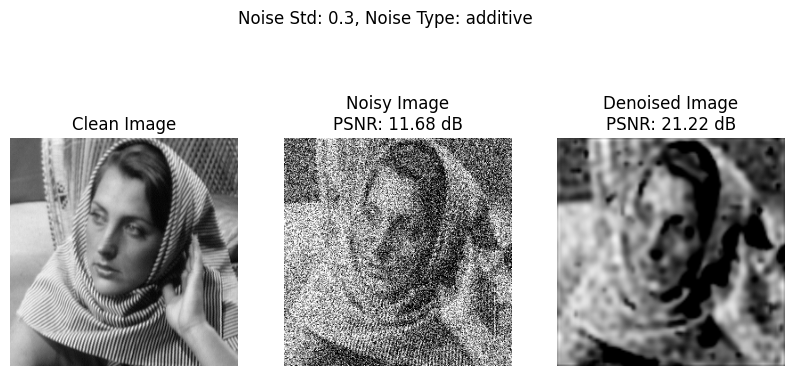

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11464119702577591
Step 10, Loss: 0.096290722489357
Step 20, Loss: 0.09075517952442169
Step 30, Loss: 0.08891680836677551
Step 40, Loss: 0.08814483135938644
Step 50, Loss: 0.08768238872289658
Step 60, Loss: 0.0873052179813385
Step 70, Loss: 0.08697467297315598
Step 80, Loss: 0.08664601296186447
Step 90, Loss: 0.08632805943489075
Step 100, Loss: 0.08601053059101105
Step 110, Loss: 0.08568485081195831
Step 120, Loss: 0.08531617373228073
Step 130, Loss: 0.0853029265999794
Step 140, Loss: 0.08473935723304749
Step 150, Loss: 0.0844460129737854
Step 160, Loss: 0.08424979448318481
Step 170, Loss: 0.0839182585477829
Step 180, Loss: 0.08350413292646408
Step 190, Loss: 0.08322487026453018
Time lapsed 15.501193761825562


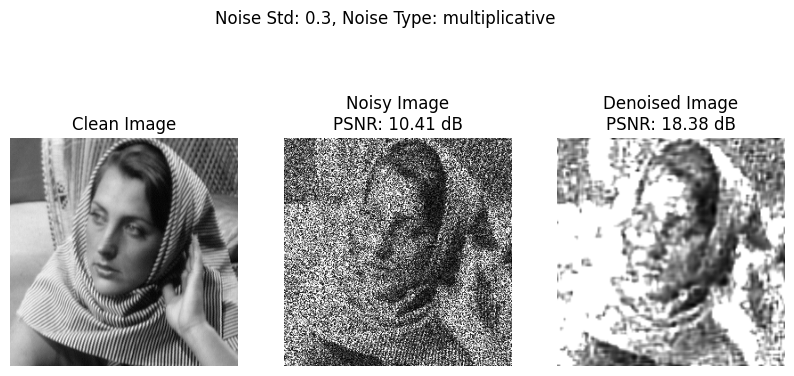

Image: boats.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.18 dB, Average PSNR (Denoised): 22.46 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07262813299894333
Step 10, Loss: 0.03040187992155552
Step 20, Loss: 0.02243654802441597
Step 30, Loss: 0.018735378980636597
Step 40, Loss: 0.01714419387280941
Step 50, Loss: 0.016038309782743454
Step 60, Loss: 0.015299343504011631
Step 70, Loss: 0.01467092800885439
Step 80, Loss: 0.014118580147624016
Step 90, Loss: 0.013638758100569248
Step 100, Loss: 0.0132681829854846
Step 110, Loss: 0.01298911776393652
Step 120, Loss: 0.012879210524260998
Step 130, Loss: 0.012575572356581688
Step 140, Loss: 0.012376943603157997
Step 150, Loss: 0.012321465648710728
Step 160, Loss: 0.012121466919779778
Step 170, Loss: 0.011995228007435799
Step 180, Loss: 0.012047724798321724
Step 190, Loss: 0.011808845214545727
Time lapsed 15.457583904266357


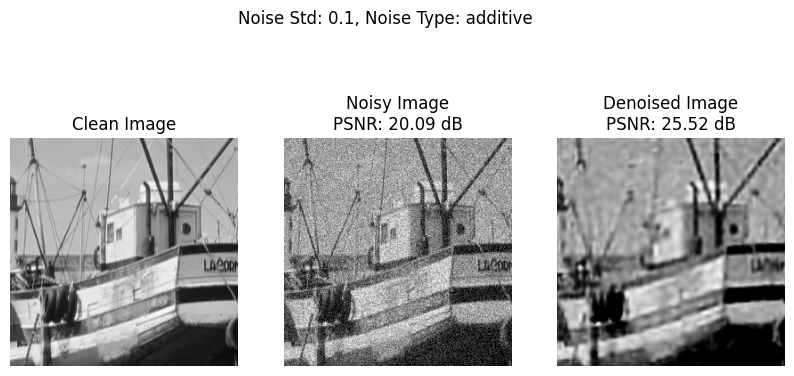

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1441269814968109
Step 10, Loss: 0.10560514032840729
Step 20, Loss: 0.10181216895580292
Step 30, Loss: 0.09580912441015244
Step 40, Loss: 0.09334921836853027
Step 50, Loss: 0.09227015823125839
Step 60, Loss: 0.09162367880344391
Step 70, Loss: 0.09111636132001877
Step 80, Loss: 0.09065056592226028
Step 90, Loss: 0.09019976109266281
Step 100, Loss: 0.08975988626480103
Step 110, Loss: 0.08933336287736893
Step 120, Loss: 0.08897212147712708
Step 130, Loss: 0.08861351013183594
Step 140, Loss: 0.08834267407655716
Step 150, Loss: 0.08797655999660492
Step 160, Loss: 0.08777359127998352
Step 170, Loss: 0.08745387941598892
Step 180, Loss: 0.08707068860530853
Step 190, Loss: 0.08712726831436157
Time lapsed 16.27431583404541


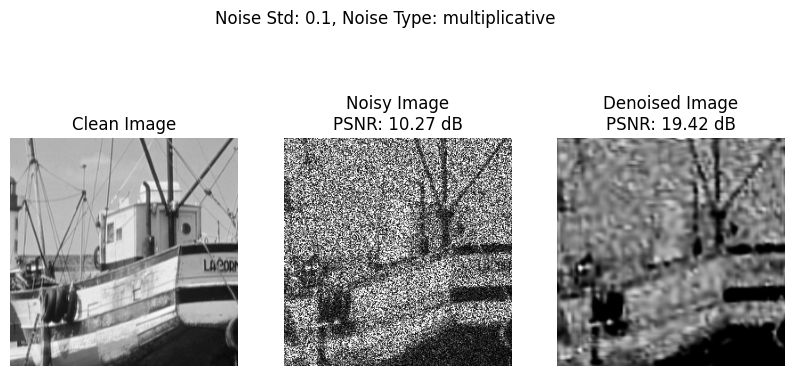

Image: boats.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.36 dB, Average PSNR (Denoised): 21.65 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07588304579257965
Step 10, Loss: 0.0594998300075531
Step 20, Loss: 0.047133591026067734
Step 30, Loss: 0.043595582246780396
Step 40, Loss: 0.04204677417874336
Step 50, Loss: 0.041227493435144424
Step 60, Loss: 0.040624286979436874
Step 70, Loss: 0.04009613022208214
Step 80, Loss: 0.03956780582666397
Step 90, Loss: 0.03906257450580597
Step 100, Loss: 0.03868991881608963
Step 110, Loss: 0.03820193186402321
Step 120, Loss: 0.03791619464755058
Step 130, Loss: 0.03785507008433342
Step 140, Loss: 0.03740914911031723
Step 150, Loss: 0.03728150948882103
Step 160, Loss: 0.037025079131126404
Step 170, Loss: 0.036881230771541595
Step 180, Loss: 0.03663678094744682
Step 190, Loss: 0.03650647774338722
Time lapsed 15.493313074111938


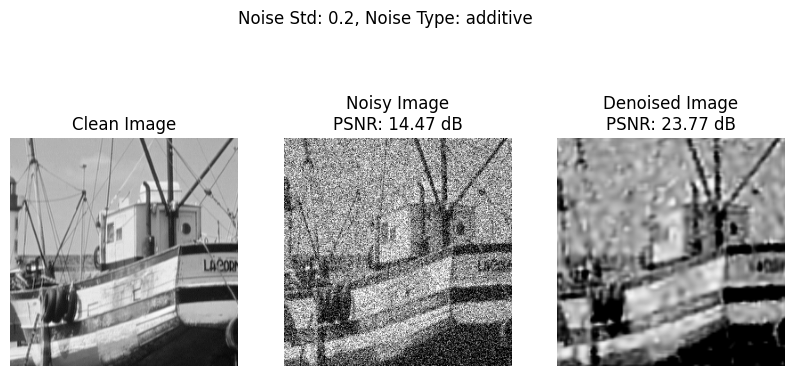

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.15530778467655182
Step 10, Loss: 0.10069674253463745
Step 20, Loss: 0.0986330434679985
Step 30, Loss: 0.09452033042907715
Step 40, Loss: 0.09397708624601364
Step 50, Loss: 0.09334779530763626
Step 60, Loss: 0.09294044971466064
Step 70, Loss: 0.09231951087713242
Step 80, Loss: 0.09182317554950714
Step 90, Loss: 0.09147365391254425
Step 100, Loss: 0.0911639854311943
Step 110, Loss: 0.09082629531621933
Step 120, Loss: 0.09047083556652069
Step 130, Loss: 0.09013214707374573
Step 140, Loss: 0.08980758488178253
Step 150, Loss: 0.0895962193608284
Step 160, Loss: 0.08957640081644058
Step 170, Loss: 0.08925952017307281
Step 180, Loss: 0.08957542479038239
Step 190, Loss: 0.08912821114063263
Time lapsed 15.667969942092896


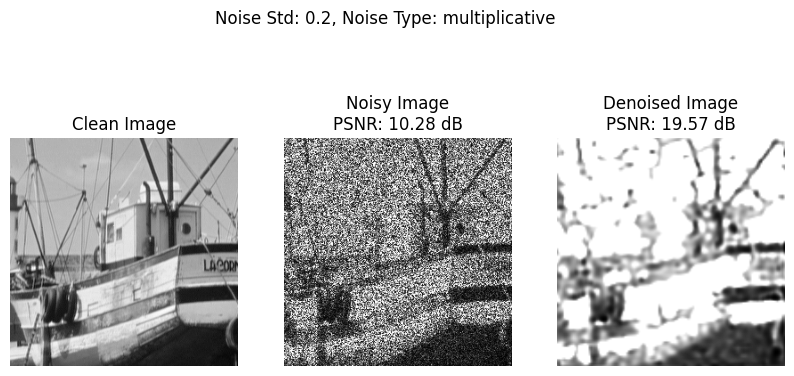

Image: boats.tif, Noise Std: 0.3
Average PSNR (Noisy): 10.99 dB, Average PSNR (Denoised): 20.65 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.10314586013555527
Step 10, Loss: 0.08641104400157928
Step 20, Loss: 0.07669923454523087
Step 30, Loss: 0.07336035370826721
Step 40, Loss: 0.07204640656709671
Step 50, Loss: 0.07118917256593704
Step 60, Loss: 0.07050833106040955
Step 70, Loss: 0.06986179947853088
Step 80, Loss: 0.06922931969165802
Step 90, Loss: 0.06858804821968079
Step 100, Loss: 0.06801053136587143
Step 110, Loss: 0.06749659776687622
Step 120, Loss: 0.06700865179300308
Step 130, Loss: 0.0667971670627594
Step 140, Loss: 0.06644079089164734
Step 150, Loss: 0.0659942477941513
Step 160, Loss: 0.06580284982919693
Step 170, Loss: 0.06529418379068375
Step 180, Loss: 0.06631898880004883
Step 190, Loss: 0.06524279713630676
Time lapsed 16.094311475753784


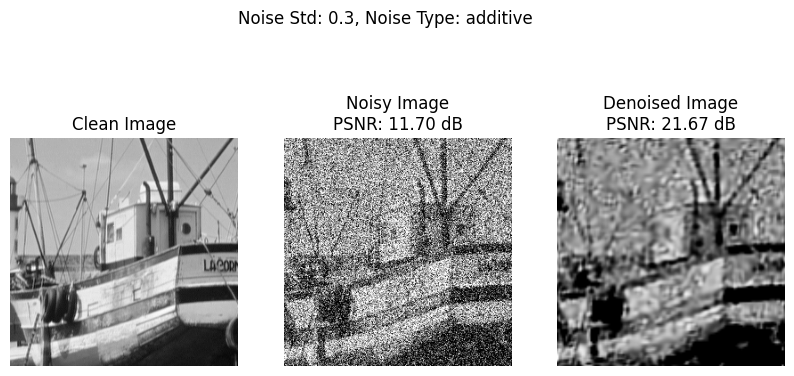

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.18586140871047974
Step 10, Loss: 0.10776925086975098
Step 20, Loss: 0.09933652728796005
Step 30, Loss: 0.09538498520851135
Step 40, Loss: 0.09464754909276962
Step 50, Loss: 0.09346938878297806
Step 60, Loss: 0.09296301752328873
Step 70, Loss: 0.09245043992996216
Step 80, Loss: 0.0921100303530693
Step 90, Loss: 0.09180141240358353
Step 100, Loss: 0.09151413291692734
Step 110, Loss: 0.09124967455863953
Step 120, Loss: 0.09096338599920273
Step 130, Loss: 0.09068935364484787
Step 140, Loss: 0.09042400866746902
Step 150, Loss: 0.09016852080821991
Step 160, Loss: 0.08995108306407928
Step 170, Loss: 0.08972618728876114
Step 180, Loss: 0.08960890769958496
Step 190, Loss: 0.08927801996469498
Time lapsed 15.784648656845093


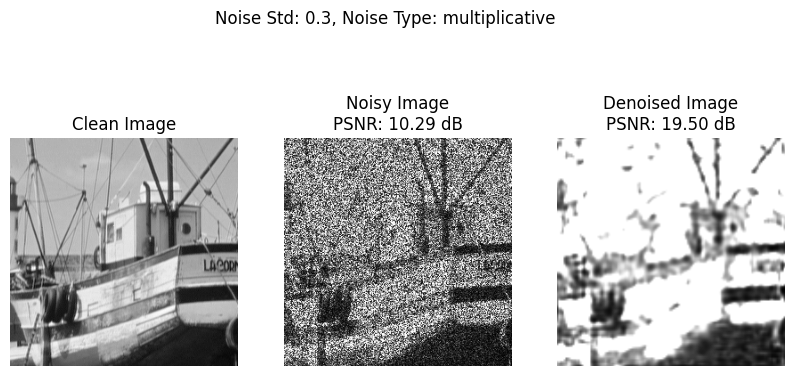

Image: cameraman.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.55 dB, Average PSNR (Denoised): 20.30 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.06626351177692413
Step 10, Loss: 0.03140101581811905
Step 20, Loss: 0.01891937479376793
Step 30, Loss: 0.017407074570655823
Step 40, Loss: 0.016366824507713318
Step 50, Loss: 0.015713058412075043
Step 60, Loss: 0.01518221478909254
Step 70, Loss: 0.014803636819124222
Step 80, Loss: 0.014410559087991714
Step 90, Loss: 0.014333518221974373
Step 100, Loss: 0.013916103169322014
Step 110, Loss: 0.013735519722104073
Step 120, Loss: 0.013516068458557129
Step 130, Loss: 0.013536910526454449
Step 140, Loss: 0.013259703293442726
Step 150, Loss: 0.013220643624663353
Step 160, Loss: 0.013175982981920242
Step 170, Loss: 0.013006415218114853
Step 180, Loss: 0.012856855057179928
Step 190, Loss: 0.01285697054117918
Time lapsed 15.777217388153076


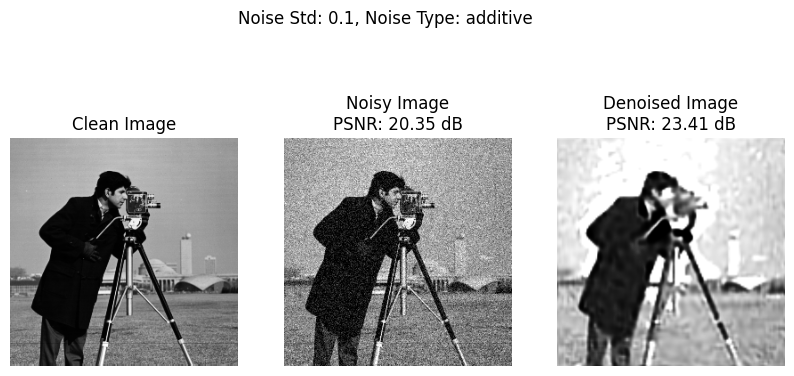

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.18201306462287903
Step 10, Loss: 0.0959736704826355
Step 20, Loss: 0.08799443393945694
Step 30, Loss: 0.08540815114974976
Step 40, Loss: 0.08452188968658447
Step 50, Loss: 0.08376284688711166
Step 60, Loss: 0.0833112895488739
Step 70, Loss: 0.08292526751756668
Step 80, Loss: 0.0825083926320076
Step 90, Loss: 0.0823526680469513
Step 100, Loss: 0.08194094151258469
Step 110, Loss: 0.08215592056512833
Step 120, Loss: 0.08148902654647827
Step 130, Loss: 0.08207837492227554
Step 140, Loss: 0.08120285719633102
Step 150, Loss: 0.0807022675871849
Step 160, Loss: 0.08031163364648819
Step 170, Loss: 0.08068782091140747
Step 180, Loss: 0.08000683784484863
Step 190, Loss: 0.08141619712114334
Time lapsed 15.77996826171875


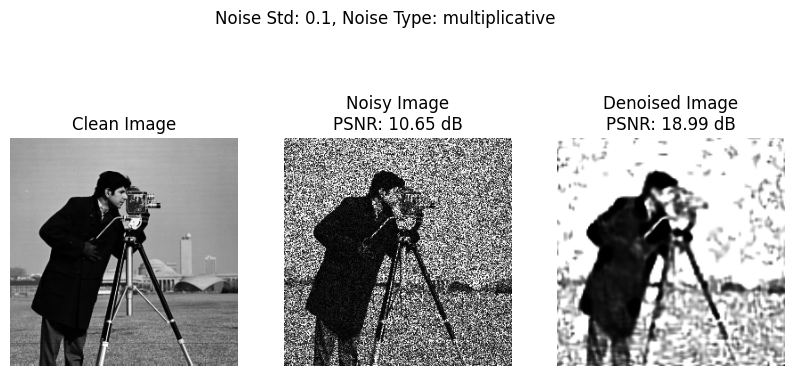

Image: cameraman.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.69 dB, Average PSNR (Denoised): 20.06 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.10053693503141403
Step 10, Loss: 0.06140753999352455
Step 20, Loss: 0.04837566986680031
Step 30, Loss: 0.04407674819231033
Step 40, Loss: 0.042011868208646774
Step 50, Loss: 0.04116131737828255
Step 60, Loss: 0.0405745729804039
Step 70, Loss: 0.04009506106376648
Step 80, Loss: 0.03963165730237961
Step 90, Loss: 0.039172422140836716
Step 100, Loss: 0.03872068598866463
Step 110, Loss: 0.03826560825109482
Step 120, Loss: 0.037891685962677
Step 130, Loss: 0.03759137541055679
Step 140, Loss: 0.037311285734176636
Step 150, Loss: 0.03699033707380295
Step 160, Loss: 0.03702577203512192
Step 170, Loss: 0.0367647260427475
Step 180, Loss: 0.036493413150310516
Step 190, Loss: 0.0365275964140892
Time lapsed 16.680137634277344


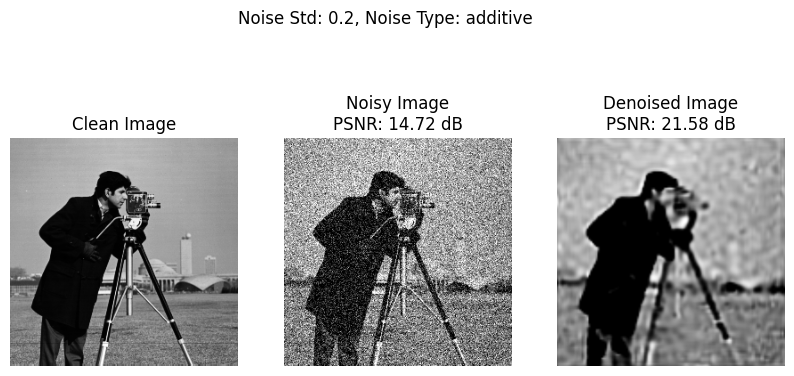

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14229589700698853
Step 10, Loss: 0.11008404195308685
Step 20, Loss: 0.09230157732963562
Step 30, Loss: 0.08782196044921875
Step 40, Loss: 0.08578943461179733
Step 50, Loss: 0.08461894094944
Step 60, Loss: 0.08378137648105621
Step 70, Loss: 0.08304063230752945
Step 80, Loss: 0.0824456661939621
Step 90, Loss: 0.0819382444024086
Step 100, Loss: 0.08127020299434662
Step 110, Loss: 0.08071325719356537
Step 120, Loss: 0.08029120415449142
Step 130, Loss: 0.07981090247631073
Step 140, Loss: 0.0795445665717125
Step 150, Loss: 0.07910037040710449
Step 160, Loss: 0.07842212915420532
Step 170, Loss: 0.07979720830917358
Step 180, Loss: 0.07795354723930359
Step 190, Loss: 0.0770665630698204
Time lapsed 15.788768768310547


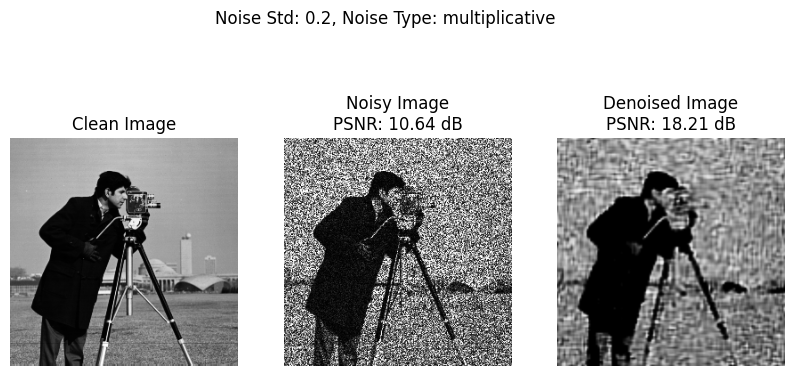

Image: cameraman.tif, Noise Std: 0.3
Average PSNR (Noisy): 11.25 dB, Average PSNR (Denoised): 19.41 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14889684319496155
Step 10, Loss: 0.07529012113809586
Step 20, Loss: 0.07239381223917007
Step 30, Loss: 0.06938739120960236
Step 40, Loss: 0.06781380623579025
Step 50, Loss: 0.0667455643415451
Step 60, Loss: 0.06600195914506912
Step 70, Loss: 0.06537474691867828
Step 80, Loss: 0.06496968865394592
Step 90, Loss: 0.06463618576526642
Step 100, Loss: 0.06427435576915741
Step 110, Loss: 0.06583652645349503
Step 120, Loss: 0.06412568688392639
Step 130, Loss: 0.06364696472883224
Step 140, Loss: 0.06343089044094086
Step 150, Loss: 0.06312846392393112
Step 160, Loss: 0.06305261701345444
Step 170, Loss: 0.0627077966928482
Step 180, Loss: 0.06277381628751755
Step 190, Loss: 0.06253945082426071
Time lapsed 15.898356676101685


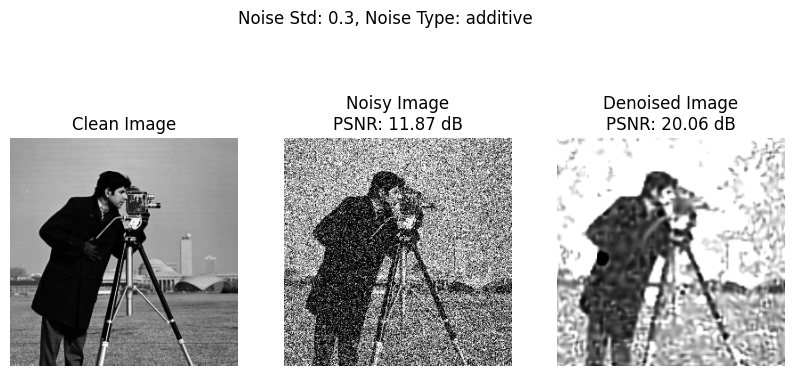

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14751850068569183
Step 10, Loss: 0.10113517194986343
Step 20, Loss: 0.08938252180814743
Step 30, Loss: 0.08684967458248138
Step 40, Loss: 0.08542419970035553
Step 50, Loss: 0.08448357880115509
Step 60, Loss: 0.0836632028222084
Step 70, Loss: 0.08292951434850693
Step 80, Loss: 0.08225714415311813
Step 90, Loss: 0.08162245899438858
Step 100, Loss: 0.08111239224672318
Step 110, Loss: 0.08085697889328003
Step 120, Loss: 0.0802934393286705
Step 130, Loss: 0.0798778235912323
Step 140, Loss: 0.0797639861702919
Step 150, Loss: 0.07924150675535202
Step 160, Loss: 0.07870084792375565
Step 170, Loss: 0.07841657102108002
Step 180, Loss: 0.07811006903648376
Step 190, Loss: 0.078167624771595
Time lapsed 16.806437015533447


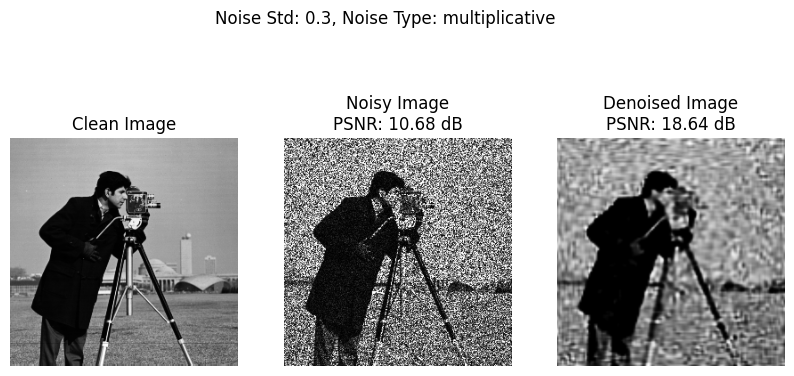

Image: foreman.tif, Noise Std: 0.1
Average PSNR (Noisy): 14.81 dB, Average PSNR (Denoised): 22.49 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07990744709968567
Step 10, Loss: 0.020861104130744934
Step 20, Loss: 0.0129786916077137
Step 30, Loss: 0.012616793625056744
Step 40, Loss: 0.011559417471289635
Step 50, Loss: 0.010683294385671616
Step 60, Loss: 0.010427413508296013
Step 70, Loss: 0.010289052501320839
Step 80, Loss: 0.010168047621846199
Step 90, Loss: 0.010075481608510017
Step 100, Loss: 0.010235360823571682
Step 110, Loss: 0.00998199824243784
Step 120, Loss: 0.009865084663033485
Step 130, Loss: 0.009782888926565647
Step 140, Loss: 0.009866420179605484
Step 150, Loss: 0.009708192199468613
Step 160, Loss: 0.009602244012057781
Step 170, Loss: 0.009899436496198177
Step 180, Loss: 0.009579023346304893
Step 190, Loss: 0.009471917524933815
Time lapsed 16.000020265579224


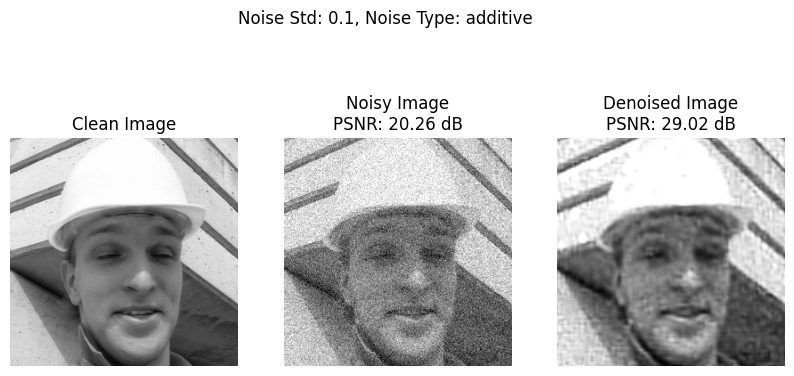

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.18643933534622192
Step 10, Loss: 0.10777761042118073
Step 20, Loss: 0.10543724149465561
Step 30, Loss: 0.10078663378953934
Step 40, Loss: 0.10003288090229034
Step 50, Loss: 0.09950003027915955
Step 60, Loss: 0.09920594841241837
Step 70, Loss: 0.09892389178276062
Step 80, Loss: 0.09871051460504532
Step 90, Loss: 0.09850931167602539
Step 100, Loss: 0.09832879155874252
Step 110, Loss: 0.09814704209566116
Step 120, Loss: 0.097969189286232
Step 130, Loss: 0.09782008081674576
Step 140, Loss: 0.09767457842826843
Step 150, Loss: 0.09752211719751358
Step 160, Loss: 0.09734988212585449
Step 170, Loss: 0.09715002030134201
Step 180, Loss: 0.09691404551267624
Step 190, Loss: 0.09663572907447815
Time lapsed 15.909693956375122


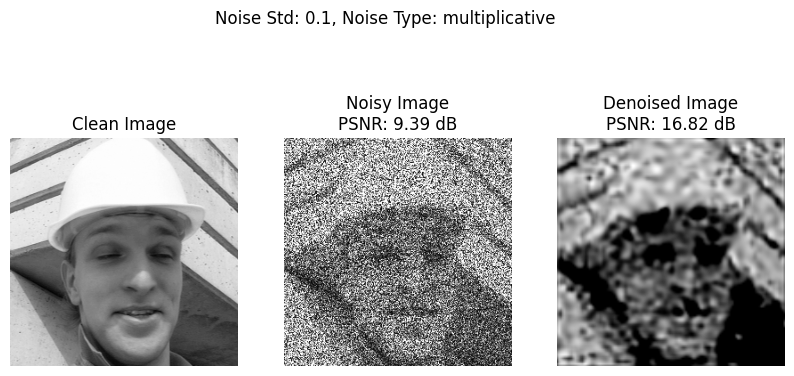

Image: foreman.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.05 dB, Average PSNR (Denoised): 20.85 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.10826145112514496
Step 10, Loss: 0.053239718079566956
Step 20, Loss: 0.04641164094209671
Step 30, Loss: 0.042387817054986954
Step 40, Loss: 0.03945541754364967
Step 50, Loss: 0.03774024918675423
Step 60, Loss: 0.03637667000293732
Step 70, Loss: 0.035860270261764526
Step 80, Loss: 0.035523466765880585
Step 90, Loss: 0.03528096526861191
Step 100, Loss: 0.035089943557977676
Step 110, Loss: 0.034929171204566956
Step 120, Loss: 0.03479066491127014
Step 130, Loss: 0.034662239253520966
Step 140, Loss: 0.034531231969594955
Step 150, Loss: 0.03439787030220032
Step 160, Loss: 0.03430244326591492
Step 170, Loss: 0.03422120586037636
Step 180, Loss: 0.0341571681201458
Step 190, Loss: 0.034108128398656845
Time lapsed 16.289737462997437


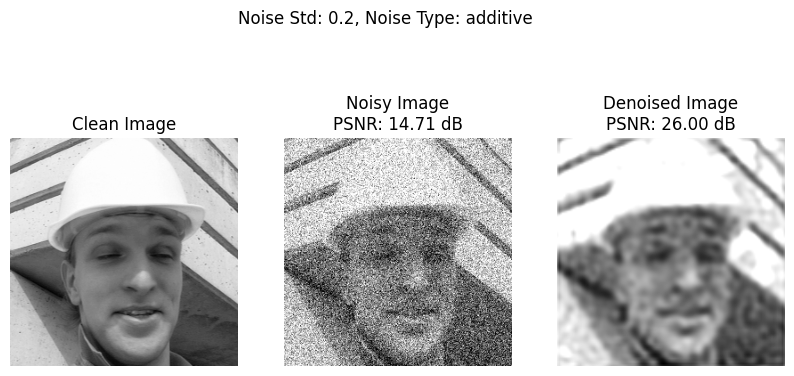

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14374202489852905
Step 10, Loss: 0.10374805331230164
Step 20, Loss: 0.10223618894815445
Step 30, Loss: 0.09969650954008102
Step 40, Loss: 0.09902148693799973
Step 50, Loss: 0.09863128513097763
Step 60, Loss: 0.09833015501499176
Step 70, Loss: 0.09812802076339722
Step 80, Loss: 0.09793785214424133
Step 90, Loss: 0.09775759279727936
Step 100, Loss: 0.0975576862692833
Step 110, Loss: 0.09738288819789886
Step 120, Loss: 0.09719695895910263
Step 130, Loss: 0.09700137376785278
Step 140, Loss: 0.09677281975746155
Step 150, Loss: 0.09649259597063065
Step 160, Loss: 0.09623608738183975
Step 170, Loss: 0.09596801549196243
Step 180, Loss: 0.09584082663059235
Step 190, Loss: 0.09555789083242416
Time lapsed 16.363141775131226


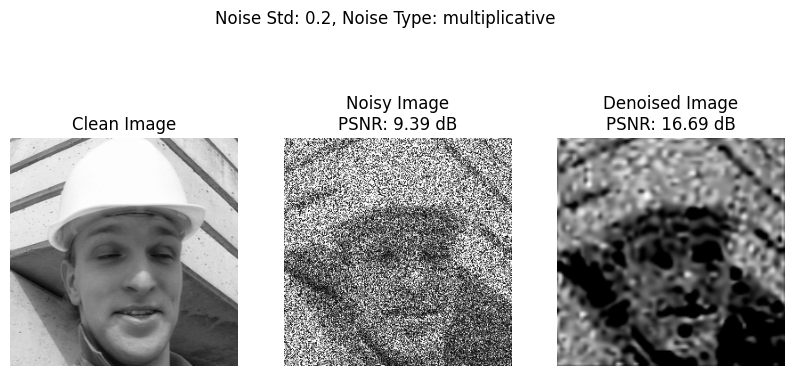

Image: foreman.tif, Noise Std: 0.3
Average PSNR (Noisy): 10.66 dB, Average PSNR (Denoised): 20.23 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.10502590984106064
Step 10, Loss: 0.07632628083229065
Step 20, Loss: 0.06904518604278564
Step 30, Loss: 0.06660230457782745
Step 40, Loss: 0.06564304232597351
Step 50, Loss: 0.06508141756057739
Step 60, Loss: 0.06473632156848907
Step 70, Loss: 0.064507856965065
Step 80, Loss: 0.0643063336610794
Step 90, Loss: 0.06410042196512222
Step 100, Loss: 0.06392725557088852
Step 110, Loss: 0.06374017894268036
Step 120, Loss: 0.06354739516973495
Step 130, Loss: 0.06337619572877884
Step 140, Loss: 0.06317541748285294
Step 150, Loss: 0.0629919096827507
Step 160, Loss: 0.06282028555870056
Step 170, Loss: 0.06264541298151016
Step 180, Loss: 0.06250692903995514
Step 190, Loss: 0.06239597499370575
Time lapsed 16.09729790687561


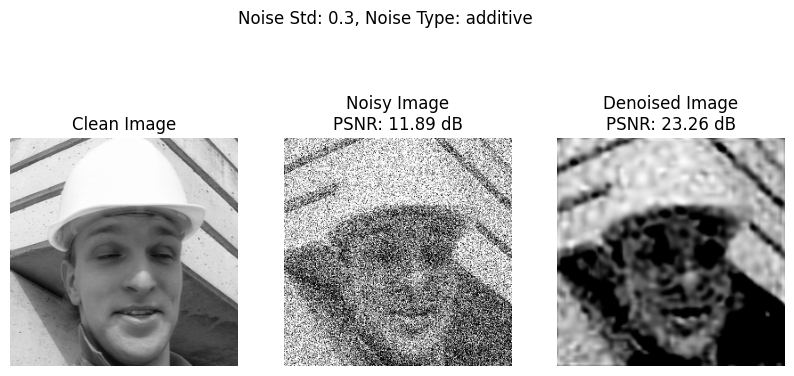

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1483057588338852
Step 10, Loss: 0.10378794372081757
Step 20, Loss: 0.10143930464982986
Step 30, Loss: 0.09901213645935059
Step 40, Loss: 0.0982326790690422
Step 50, Loss: 0.09724663943052292
Step 60, Loss: 0.096490278840065
Step 70, Loss: 0.09579930454492569
Step 80, Loss: 0.09539569914340973
Step 90, Loss: 0.09489291161298752
Step 100, Loss: 0.09433512389659882
Step 110, Loss: 0.09451986104249954
Step 120, Loss: 0.0935664027929306
Step 130, Loss: 0.09320396184921265
Step 140, Loss: 0.09299059957265854
Step 150, Loss: 0.09260144084692001
Step 160, Loss: 0.0923195481300354
Step 170, Loss: 0.09210280328989029
Step 180, Loss: 0.09250275790691376
Step 190, Loss: 0.09149618446826935
Time lapsed 16.182230949401855


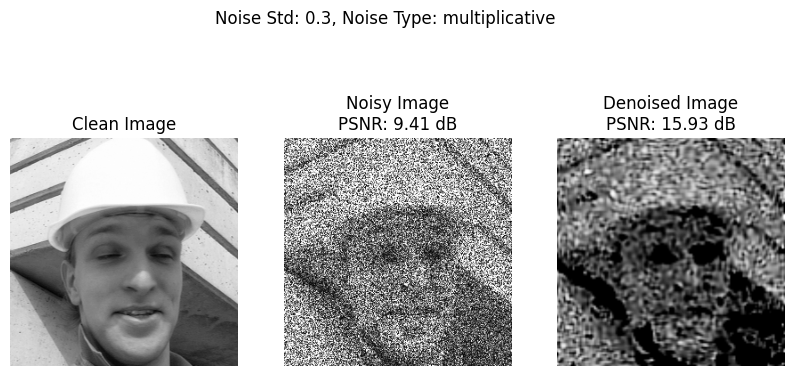

Image: house.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.01 dB, Average PSNR (Denoised): 22.77 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07509667426347733
Step 10, Loss: 0.028363319113850594
Step 20, Loss: 0.02331123873591423
Step 30, Loss: 0.020848914980888367
Step 40, Loss: 0.019005469977855682
Step 50, Loss: 0.017580650746822357
Step 60, Loss: 0.016065368428826332
Step 70, Loss: 0.014903365634381771
Step 80, Loss: 0.014178171753883362
Step 90, Loss: 0.01367201004177332
Step 100, Loss: 0.013297069817781448
Step 110, Loss: 0.013029993511736393
Step 120, Loss: 0.012812928296625614
Step 130, Loss: 0.012613782659173012
Step 140, Loss: 0.012461641803383827
Step 150, Loss: 0.012283705174922943
Step 160, Loss: 0.01213340274989605
Step 170, Loss: 0.011980202980339527
Step 180, Loss: 0.011839976534247398
Step 190, Loss: 0.01172340102493763
Time lapsed 16.92695379257202


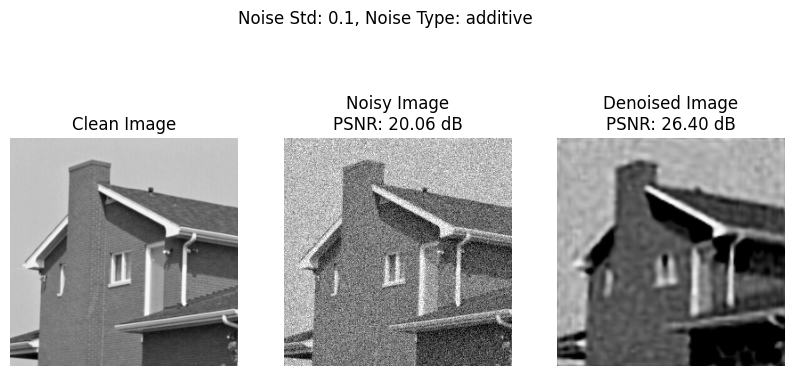

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.15017764270305634
Step 10, Loss: 0.10427086055278778
Step 20, Loss: 0.10310559719800949
Step 30, Loss: 0.10042434185743332
Step 40, Loss: 0.09892425686120987
Step 50, Loss: 0.09721377491950989
Step 60, Loss: 0.09605492651462555
Step 70, Loss: 0.09506671130657196
Step 80, Loss: 0.0943680852651596
Step 90, Loss: 0.09386017918586731
Step 100, Loss: 0.09347899258136749
Step 110, Loss: 0.09313492476940155
Step 120, Loss: 0.0928095281124115
Step 130, Loss: 0.09252078086137772
Step 140, Loss: 0.0922459289431572
Step 150, Loss: 0.09189130365848541
Step 160, Loss: 0.09159556031227112
Step 170, Loss: 0.09122057259082794
Step 180, Loss: 0.09125051647424698
Step 190, Loss: 0.09070858359336853
Time lapsed 16.16509985923767


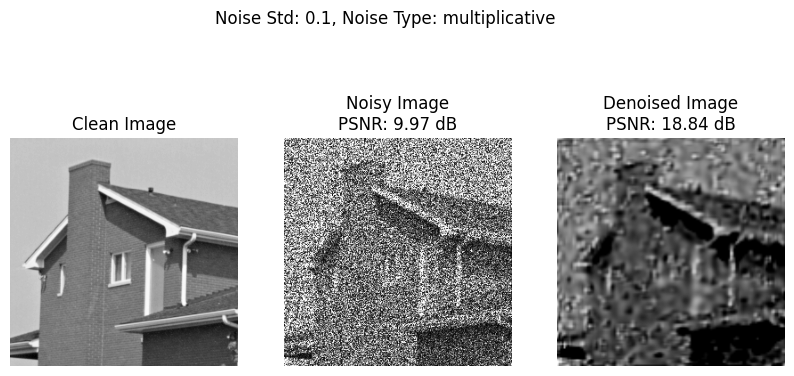

Image: house.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.21 dB, Average PSNR (Denoised): 22.03 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.09533548355102539
Step 10, Loss: 0.05189329758286476
Step 20, Loss: 0.0479852519929409
Step 30, Loss: 0.045030202716588974
Step 40, Loss: 0.042749155312776566
Step 50, Loss: 0.04105863720178604
Step 60, Loss: 0.04008500650525093
Step 70, Loss: 0.039367467164993286
Step 80, Loss: 0.03879769146442413
Step 90, Loss: 0.038274988532066345
Step 100, Loss: 0.03781677037477493
Step 110, Loss: 0.037415504455566406
Step 120, Loss: 0.037093356251716614
Step 130, Loss: 0.036810968071222305
Step 140, Loss: 0.03665446490049362
Step 150, Loss: 0.03639295697212219
Step 160, Loss: 0.03638026863336563
Step 170, Loss: 0.03611491620540619
Step 180, Loss: 0.036190442740917206
Step 190, Loss: 0.036011241376399994
Time lapsed 16.222414016723633


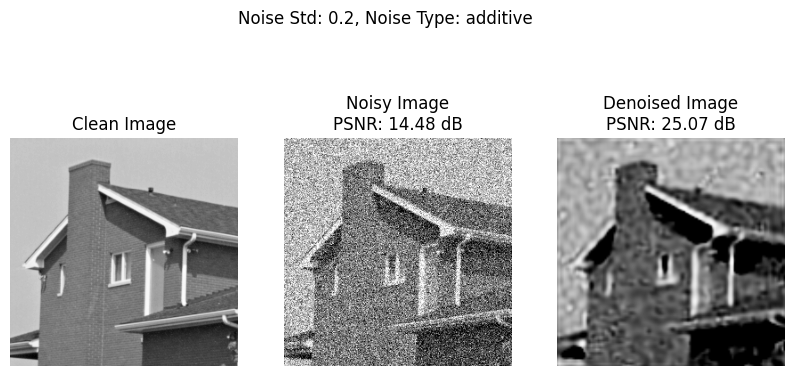

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.13501286506652832
Step 10, Loss: 0.10162370651960373
Step 20, Loss: 0.1008058413863182
Step 30, Loss: 0.09850454330444336
Step 40, Loss: 0.09648139774799347
Step 50, Loss: 0.09517200291156769
Step 60, Loss: 0.09443381428718567
Step 70, Loss: 0.09394115209579468
Step 80, Loss: 0.09351282566785812
Step 90, Loss: 0.09312596917152405
Step 100, Loss: 0.09276361763477325
Step 110, Loss: 0.09240990877151489
Step 120, Loss: 0.09206029027700424
Step 130, Loss: 0.091718390583992
Step 140, Loss: 0.09132208675146103
Step 150, Loss: 0.09118491411209106
Step 160, Loss: 0.09066399186849594
Step 170, Loss: 0.09032105654478073
Step 180, Loss: 0.09007125347852707
Step 190, Loss: 0.08962570875883102
Time lapsed 17.186015129089355


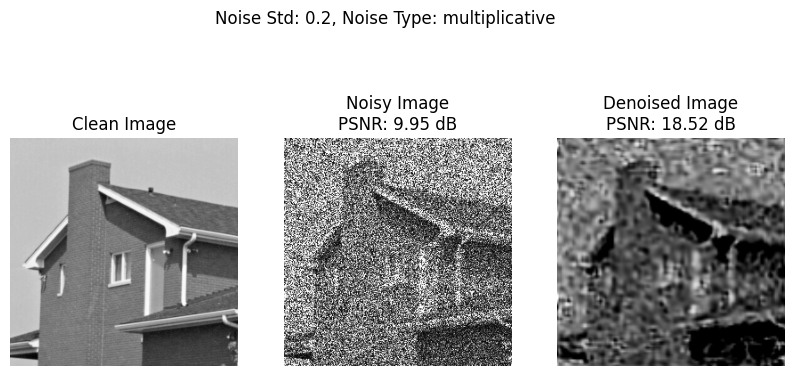

Image: house.tif, Noise Std: 0.3
Average PSNR (Noisy): 10.80 dB, Average PSNR (Denoised): 21.21 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1279548704624176
Step 10, Loss: 0.08107099682092667
Step 20, Loss: 0.0783507451415062
Step 30, Loss: 0.07472670078277588
Step 40, Loss: 0.0728003978729248
Step 50, Loss: 0.0717758759856224
Step 60, Loss: 0.07103195786476135
Step 70, Loss: 0.07050611078739166
Step 80, Loss: 0.06995169818401337
Step 90, Loss: 0.06954298168420792
Step 100, Loss: 0.06918346136808395
Step 110, Loss: 0.06883250176906586
Step 120, Loss: 0.06848721206188202
Step 130, Loss: 0.06815262138843536
Step 140, Loss: 0.06783735007047653
Step 150, Loss: 0.06756480038166046
Step 160, Loss: 0.06735056638717651
Step 170, Loss: 0.06706170737743378
Step 180, Loss: 0.06682728230953217
Step 190, Loss: 0.06694099307060242
Time lapsed 16.377055883407593


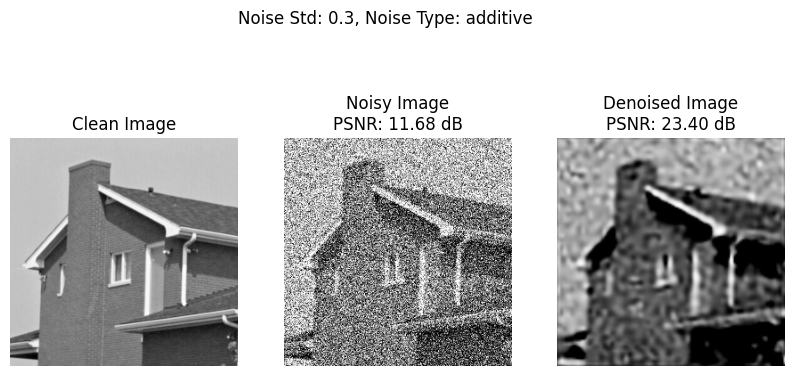

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14596563577651978
Step 10, Loss: 0.09938506036996841
Step 20, Loss: 0.09865325689315796
Step 30, Loss: 0.09609728306531906
Step 40, Loss: 0.09529729187488556
Step 50, Loss: 0.0947684645652771
Step 60, Loss: 0.0943683311343193
Step 70, Loss: 0.09410275518894196
Step 80, Loss: 0.09385717660188675
Step 90, Loss: 0.09366186708211899
Step 100, Loss: 0.09348607063293457
Step 110, Loss: 0.09331157803535461
Step 120, Loss: 0.0931260958313942
Step 130, Loss: 0.0929185226559639
Step 140, Loss: 0.09272947907447815
Step 150, Loss: 0.09262767434120178
Step 160, Loss: 0.09236259758472443
Step 170, Loss: 0.09210112690925598
Step 180, Loss: 0.09195532649755478
Step 190, Loss: 0.09171870350837708
Time lapsed 16.364200830459595


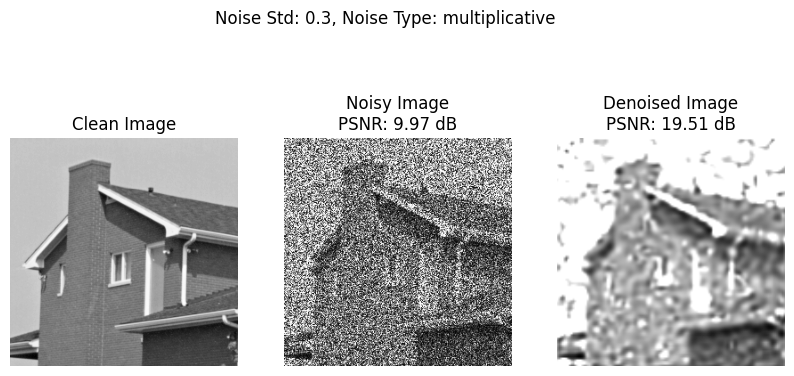

Image: Monarch.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.56 dB, Average PSNR (Denoised): 21.40 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.08673424273729324
Step 10, Loss: 0.03758152201771736
Step 20, Loss: 0.03287922218441963
Step 30, Loss: 0.030113359913229942
Step 40, Loss: 0.02811388485133648
Step 50, Loss: 0.026667991653084755
Step 60, Loss: 0.02492871880531311
Step 70, Loss: 0.023634854704141617
Step 80, Loss: 0.02239009365439415
Step 90, Loss: 0.020691735669970512
Step 100, Loss: 0.019477710127830505
Step 110, Loss: 0.01863534189760685
Step 120, Loss: 0.017909271642565727
Step 130, Loss: 0.01743113249540329
Step 140, Loss: 0.016991306096315384
Step 150, Loss: 0.01670769229531288
Step 160, Loss: 0.016641996800899506
Step 170, Loss: 0.016192087903618813
Step 180, Loss: 0.016078954562544823
Step 190, Loss: 0.015868432819843292
Time lapsed 17.35092306137085


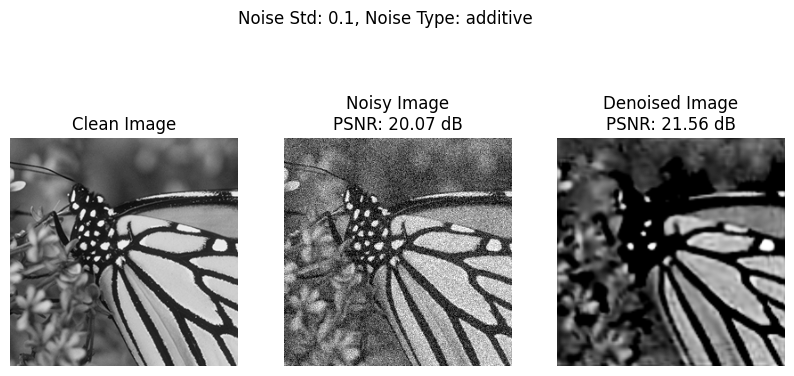

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1414230465888977
Step 10, Loss: 0.08974206447601318
Step 20, Loss: 0.08939016610383987
Step 30, Loss: 0.0857783779501915
Step 40, Loss: 0.08432106673717499
Step 50, Loss: 0.08299122005701065
Step 60, Loss: 0.08205850422382355
Step 70, Loss: 0.08094768971204758
Step 80, Loss: 0.07967256754636765
Step 90, Loss: 0.07853966951370239
Step 100, Loss: 0.07761848717927933
Step 110, Loss: 0.07675940543413162
Step 120, Loss: 0.07665944844484329
Step 130, Loss: 0.07580694556236267
Step 140, Loss: 0.07515288889408112
Step 150, Loss: 0.0747491866350174
Step 160, Loss: 0.07473044842481613
Step 170, Loss: 0.07419676333665848
Step 180, Loss: 0.0735107809305191
Step 190, Loss: 0.07362735271453857
Time lapsed 16.426701068878174


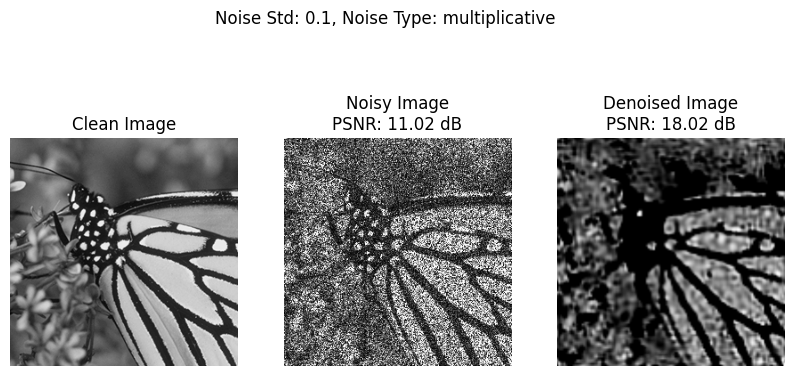

Image: Monarch.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.78 dB, Average PSNR (Denoised): 19.80 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.09020434319972992
Step 10, Loss: 0.06645330041646957
Step 20, Loss: 0.06265134364366531
Step 30, Loss: 0.05774947628378868
Step 40, Loss: 0.05069641396403313
Step 50, Loss: 0.04611428081989288
Step 60, Loss: 0.04367911070585251
Step 70, Loss: 0.04201086610555649
Step 80, Loss: 0.04091110825538635
Step 90, Loss: 0.04003202170133591
Step 100, Loss: 0.039302289485931396
Step 110, Loss: 0.03884896636009216
Step 120, Loss: 0.038335561752319336
Step 130, Loss: 0.03788409009575844
Step 140, Loss: 0.037782393395900726
Step 150, Loss: 0.037307657301425934
Step 160, Loss: 0.03691486269235611
Step 170, Loss: 0.03684702515602112
Step 180, Loss: 0.03657422959804535
Step 190, Loss: 0.036382924765348434
Time lapsed 16.536860466003418


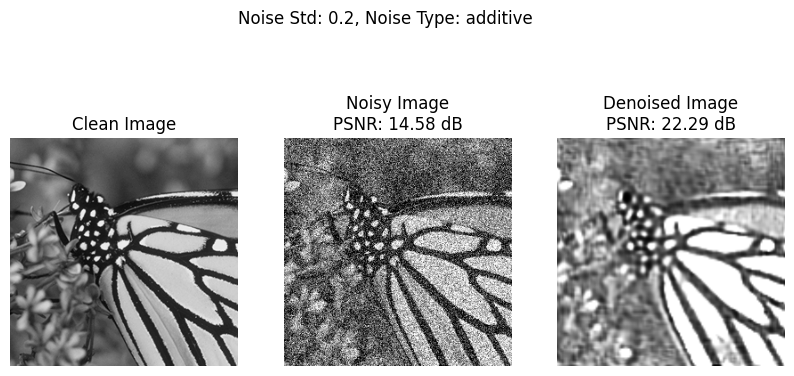

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11453881859779358
Step 10, Loss: 0.09351464360952377
Step 20, Loss: 0.09174257516860962
Step 30, Loss: 0.08954435586929321
Step 40, Loss: 0.08628293871879578
Step 50, Loss: 0.08266887813806534
Step 60, Loss: 0.08015500754117966
Step 70, Loss: 0.0785984918475151
Step 80, Loss: 0.07749437540769577
Step 90, Loss: 0.07665756344795227
Step 100, Loss: 0.07700984179973602
Step 110, Loss: 0.07591790705919266
Step 120, Loss: 0.07531758397817612
Step 130, Loss: 0.07510513812303543
Step 140, Loss: 0.07569142431020737
Step 150, Loss: 0.07470803707838058
Step 160, Loss: 0.07433449476957321
Step 170, Loss: 0.07398362457752228
Step 180, Loss: 0.07348630577325821
Step 190, Loss: 0.07321595400571823
Time lapsed 17.58108901977539


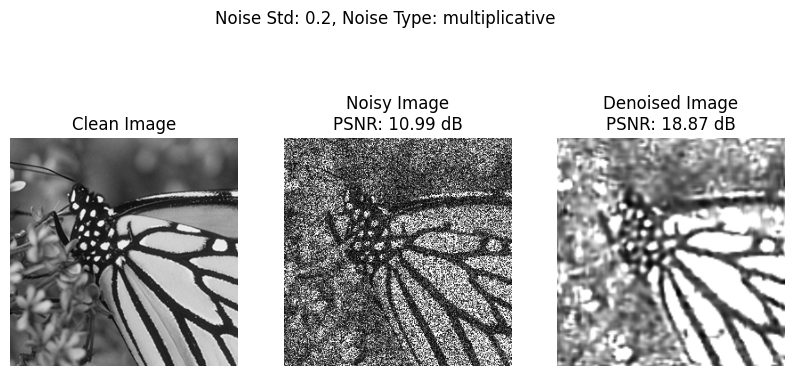

Image: Monarch.tif, Noise Std: 0.3
Average PSNR (Noisy): 11.39 dB, Average PSNR (Denoised): 19.26 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.09725838899612427
Step 10, Loss: 0.07464752346277237
Step 20, Loss: 0.07050083577632904
Step 30, Loss: 0.06890151649713516
Step 40, Loss: 0.06765738874673843
Step 50, Loss: 0.0669955164194107
Step 60, Loss: 0.06826812773942947
Step 70, Loss: 0.06633016467094421
Step 80, Loss: 0.06572666764259338
Step 90, Loss: 0.06514164805412292
Step 100, Loss: 0.06487848609685898
Step 110, Loss: 0.06475304812192917
Step 120, Loss: 0.06427542865276337
Step 130, Loss: 0.06429099291563034
Step 140, Loss: 0.06369804590940475
Step 150, Loss: 0.0635855570435524
Step 160, Loss: 0.06303459405899048
Step 170, Loss: 0.06415379792451859
Step 180, Loss: 0.06304562836885452
Step 190, Loss: 0.062469542026519775
Time lapsed 16.64753293991089


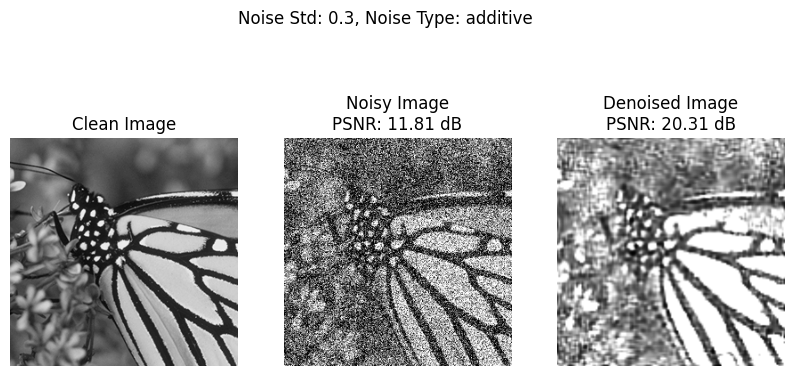

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.14270511269569397
Step 10, Loss: 0.09360121935606003
Step 20, Loss: 0.09203467518091202
Step 30, Loss: 0.08957414329051971
Step 40, Loss: 0.08728256821632385
Step 50, Loss: 0.08457972854375839
Step 60, Loss: 0.08239401131868362
Step 70, Loss: 0.08056698739528656
Step 80, Loss: 0.07906743884086609
Step 90, Loss: 0.07812429219484329
Step 100, Loss: 0.07744809985160828
Step 110, Loss: 0.07686536014080048
Step 120, Loss: 0.07651709765195847
Step 130, Loss: 0.07602734118700027
Step 140, Loss: 0.07572206109762192
Step 150, Loss: 0.07542648166418076
Step 160, Loss: 0.07530564814805984
Step 170, Loss: 0.0750206783413887
Step 180, Loss: 0.0747554749250412
Step 190, Loss: 0.07490243017673492
Time lapsed 16.65775156021118


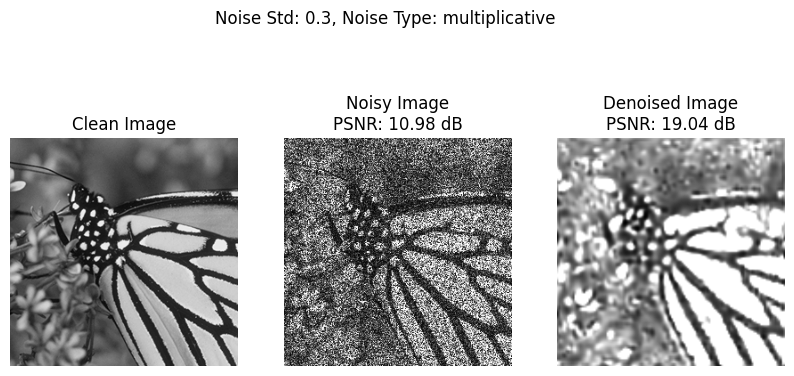

Image: Parrots.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.19 dB, Average PSNR (Denoised): 20.54 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.06575892865657806
Step 10, Loss: 0.03433098644018173
Step 20, Loss: 0.02096269652247429
Step 30, Loss: 0.01699882373213768
Step 40, Loss: 0.015948491171002388
Step 50, Loss: 0.015186836943030357
Step 60, Loss: 0.014669639989733696
Step 70, Loss: 0.014210199937224388
Step 80, Loss: 0.013778806664049625
Step 90, Loss: 0.01339622400701046
Step 100, Loss: 0.013116266578435898
Step 110, Loss: 0.012944327667355537
Step 120, Loss: 0.012680396437644958
Step 130, Loss: 0.012510906904935837
Step 140, Loss: 0.012447884306311607
Step 150, Loss: 0.012228432111442089
Step 160, Loss: 0.012084996327757835
Step 170, Loss: 0.011947440914809704
Step 180, Loss: 0.0118898069486022
Step 190, Loss: 0.011828815564513206
Time lapsed 17.58135747909546


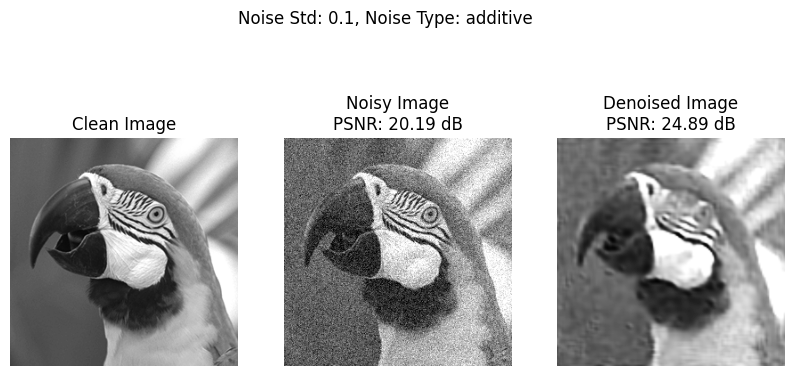

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.13786157965660095
Step 10, Loss: 0.09309345483779907
Step 20, Loss: 0.09127061069011688
Step 30, Loss: 0.08810056746006012
Step 40, Loss: 0.08715849369764328
Step 50, Loss: 0.08650420606136322
Step 60, Loss: 0.0860300213098526
Step 70, Loss: 0.0856899693608284
Step 80, Loss: 0.08540171384811401
Step 90, Loss: 0.08512280881404877
Step 100, Loss: 0.08482760190963745
Step 110, Loss: 0.08450397849082947
Step 120, Loss: 0.08416064083576202
Step 130, Loss: 0.0838436558842659
Step 140, Loss: 0.083900585770607
Step 150, Loss: 0.08312544226646423
Step 160, Loss: 0.08328232169151306
Step 170, Loss: 0.08245900273323059
Step 180, Loss: 0.08223642408847809
Step 190, Loss: 0.08180584758520126
Time lapsed 16.63768219947815


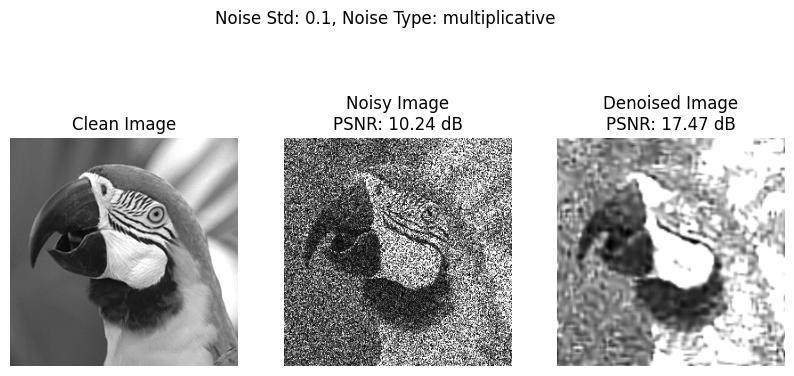

Image: Parrots.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.40 dB, Average PSNR (Denoised): 20.12 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1328148990869522
Step 10, Loss: 0.050636328756809235
Step 20, Loss: 0.04671487584710121
Step 30, Loss: 0.04265812411904335
Step 40, Loss: 0.04071749746799469
Step 50, Loss: 0.03974667564034462
Step 60, Loss: 0.03914141282439232
Step 70, Loss: 0.03868071734905243
Step 80, Loss: 0.03829255700111389
Step 90, Loss: 0.037904031574726105
Step 100, Loss: 0.037526410073041916
Step 110, Loss: 0.03716259449720383
Step 120, Loss: 0.03683127090334892
Step 130, Loss: 0.0366799533367157
Step 140, Loss: 0.036322467029094696
Step 150, Loss: 0.03598857671022415
Step 160, Loss: 0.03587961569428444
Step 170, Loss: 0.03554133325815201
Step 180, Loss: 0.03569391742348671
Step 190, Loss: 0.03531068190932274
Time lapsed 16.738318920135498


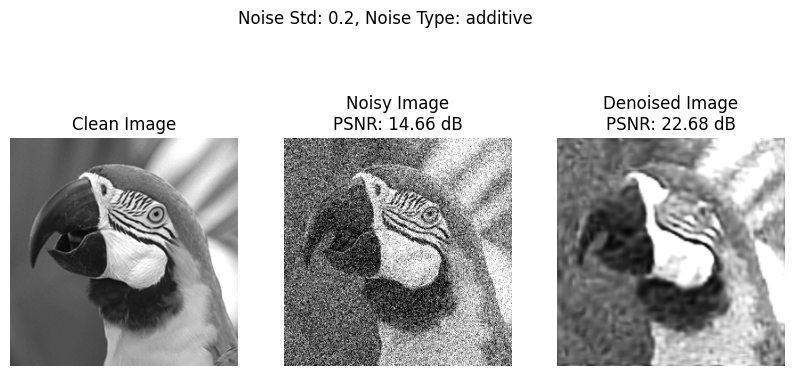

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.1308826059103012
Step 10, Loss: 0.09864889830350876
Step 20, Loss: 0.09271703660488129
Step 30, Loss: 0.09013859927654266
Step 40, Loss: 0.08847973495721817
Step 50, Loss: 0.08722046762704849
Step 60, Loss: 0.08655844628810883
Step 70, Loss: 0.08605663478374481
Step 80, Loss: 0.08561372756958008
Step 90, Loss: 0.08521200716495514
Step 100, Loss: 0.08481895178556442
Step 110, Loss: 0.08445072919130325
Step 120, Loss: 0.0840793326497078
Step 130, Loss: 0.0837070643901825
Step 140, Loss: 0.08336007595062256
Step 150, Loss: 0.08324843645095825
Step 160, Loss: 0.08272231370210648
Step 170, Loss: 0.08239162713289261
Step 180, Loss: 0.08209789544343948
Step 190, Loss: 0.08212408423423767
Time lapsed 17.65794086456299


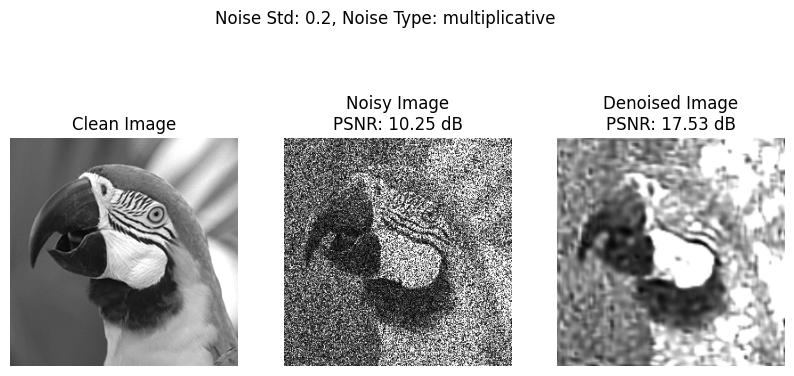

Image: Parrots.tif, Noise Std: 0.3
Average PSNR (Noisy): 11.05 dB, Average PSNR (Denoised): 19.47 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11087892204523087
Step 10, Loss: 0.07654938101768494
Step 20, Loss: 0.07159219682216644
Step 30, Loss: 0.06999167799949646
Step 40, Loss: 0.06928464025259018
Step 50, Loss: 0.06868444383144379
Step 60, Loss: 0.06806007027626038
Step 70, Loss: 0.06746656447649002
Step 80, Loss: 0.06683529913425446
Step 90, Loss: 0.06645537912845612
Step 100, Loss: 0.06618721038103104
Step 110, Loss: 0.06592483073472977
Step 120, Loss: 0.06577383726835251
Step 130, Loss: 0.06558368355035782
Step 140, Loss: 0.06539050489664078
Step 150, Loss: 0.06521743535995483
Step 160, Loss: 0.06505652517080307
Step 170, Loss: 0.06483162939548492
Step 180, Loss: 0.06466946005821228
Step 190, Loss: 0.06453963369131088
Time lapsed 16.73451519012451


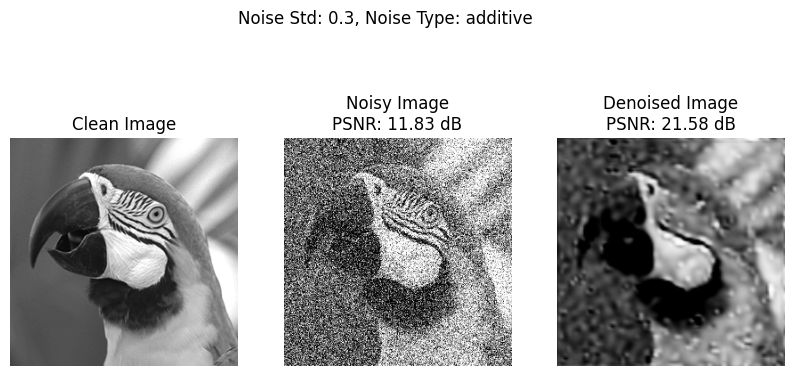

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11460461467504501
Step 10, Loss: 0.09173355996608734
Step 20, Loss: 0.08863002061843872
Step 30, Loss: 0.08740466833114624
Step 40, Loss: 0.08672250062227249
Step 50, Loss: 0.08620747923851013
Step 60, Loss: 0.08580221235752106
Step 70, Loss: 0.08543099462985992
Step 80, Loss: 0.0850522518157959
Step 90, Loss: 0.08469059318304062
Step 100, Loss: 0.084336057305336
Step 110, Loss: 0.08396802842617035
Step 120, Loss: 0.0836019441485405
Step 130, Loss: 0.08310500532388687
Step 140, Loss: 0.08279284089803696
Step 150, Loss: 0.08242809027433395
Step 160, Loss: 0.08247479051351547
Step 170, Loss: 0.08194771409034729
Step 180, Loss: 0.08224684745073318
Step 190, Loss: 0.08161068707704544
Time lapsed 16.879171133041382


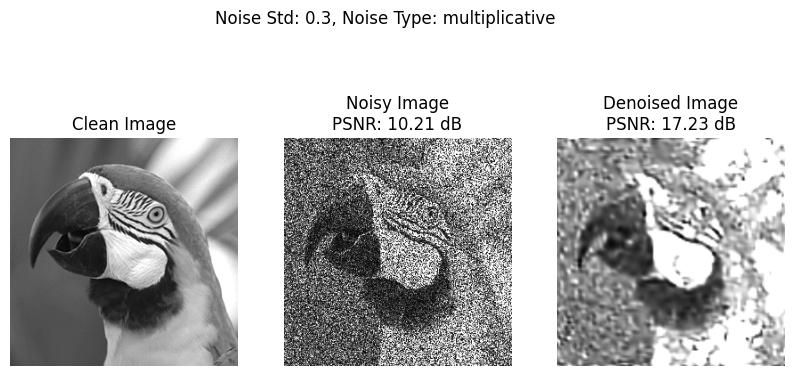

Image: peppers256.tif, Noise Std: 0.1
Average PSNR (Noisy): 15.35 dB, Average PSNR (Denoised): 21.32 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.06715933978557587
Step 10, Loss: 0.037139322608709335
Step 20, Loss: 0.02706967666745186
Step 30, Loss: 0.022527571767568588
Step 40, Loss: 0.019840732216835022
Step 50, Loss: 0.0178688932210207
Step 60, Loss: 0.01670953817665577
Step 70, Loss: 0.015756547451019287
Step 80, Loss: 0.015072786249220371
Step 90, Loss: 0.014591320417821407
Step 100, Loss: 0.014214722439646721
Step 110, Loss: 0.01391671970486641
Step 120, Loss: 0.013631868176162243
Step 130, Loss: 0.013398188166320324
Step 140, Loss: 0.013339020311832428
Step 150, Loss: 0.013105069287121296
Step 160, Loss: 0.012939495965838432
Step 170, Loss: 0.012831554748117924
Step 180, Loss: 0.012731814756989479
Step 190, Loss: 0.012638747692108154
Time lapsed 17.69960331916809


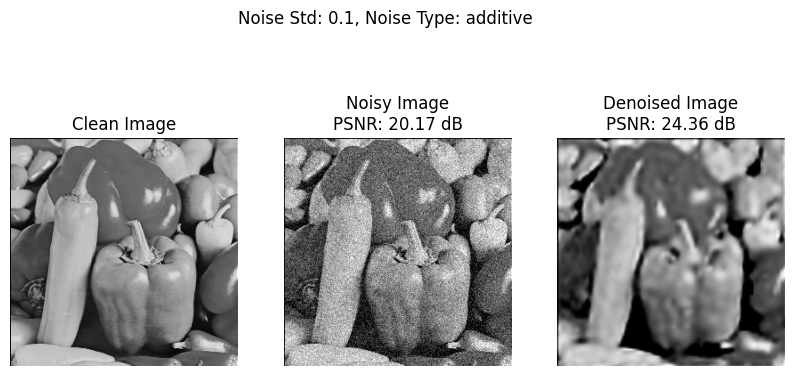

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11406563967466354
Step 10, Loss: 0.09743084013462067
Step 20, Loss: 0.09171592444181442
Step 30, Loss: 0.0887555181980133
Step 40, Loss: 0.08693668991327286
Step 50, Loss: 0.0858105942606926
Step 60, Loss: 0.08504907786846161
Step 70, Loss: 0.08451610058546066
Step 80, Loss: 0.0840219110250473
Step 90, Loss: 0.08370523899793625
Step 100, Loss: 0.0834968239068985
Step 110, Loss: 0.08325917273759842
Step 120, Loss: 0.08311127126216888
Step 130, Loss: 0.08262571692466736
Step 140, Loss: 0.0822983831167221
Step 150, Loss: 0.08243077993392944
Step 160, Loss: 0.08212576806545258
Step 170, Loss: 0.08169946074485779
Step 180, Loss: 0.08216319978237152
Step 190, Loss: 0.0815189927816391
Time lapsed 16.833163022994995


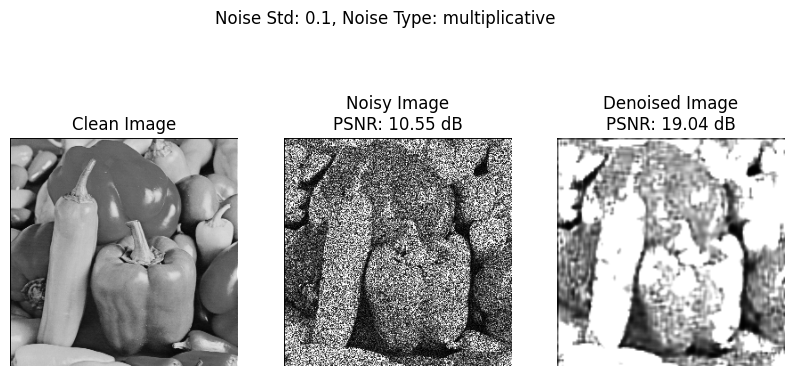

Image: peppers256.tif, Noise Std: 0.2
Average PSNR (Noisy): 12.53 dB, Average PSNR (Denoised): 21.34 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.12041940540075302
Step 10, Loss: 0.05570021644234657
Step 20, Loss: 0.05082296207547188
Step 30, Loss: 0.045239195227622986
Step 40, Loss: 0.04294811934232712
Step 50, Loss: 0.04145215079188347
Step 60, Loss: 0.04039469733834267
Step 70, Loss: 0.03958355635404587
Step 80, Loss: 0.03886690363287926
Step 90, Loss: 0.03824976831674576
Step 100, Loss: 0.037775807082653046
Step 110, Loss: 0.03745025396347046
Step 120, Loss: 0.037113603204488754
Step 130, Loss: 0.03685164451599121
Step 140, Loss: 0.03663569688796997
Step 150, Loss: 0.036443863064050674
Step 160, Loss: 0.03626521676778793
Step 170, Loss: 0.03647841513156891
Step 180, Loss: 0.03609544038772583
Step 190, Loss: 0.035936251282691956
Time lapsed 16.91856575012207


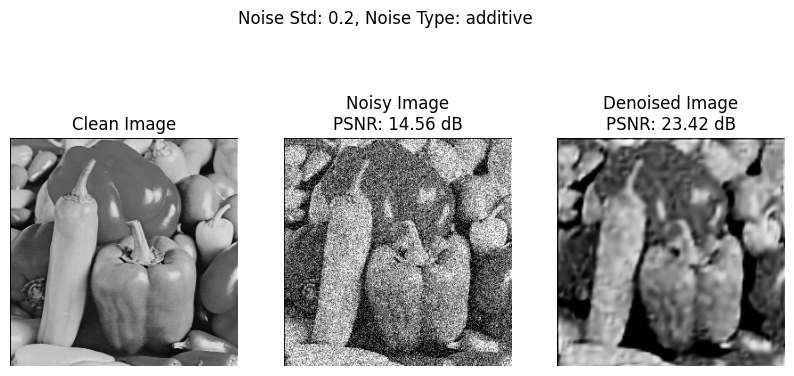

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.19001252949237823
Step 10, Loss: 0.10067756474018097
Step 20, Loss: 0.10077568888664246
Step 30, Loss: 0.09592215716838837
Step 40, Loss: 0.09391075372695923
Step 50, Loss: 0.09233609586954117
Step 60, Loss: 0.09107676893472672
Step 70, Loss: 0.09001321345567703
Step 80, Loss: 0.0890837013721466
Step 90, Loss: 0.0882607251405716
Step 100, Loss: 0.08764283359050751
Step 110, Loss: 0.08711244910955429
Step 120, Loss: 0.086508609354496
Step 130, Loss: 0.08599071204662323
Step 140, Loss: 0.08553370088338852
Step 150, Loss: 0.08510007709264755
Step 160, Loss: 0.08469510078430176
Step 170, Loss: 0.08436649292707443
Step 180, Loss: 0.0840168371796608
Step 190, Loss: 0.08371085673570633
Time lapsed 17.850889921188354


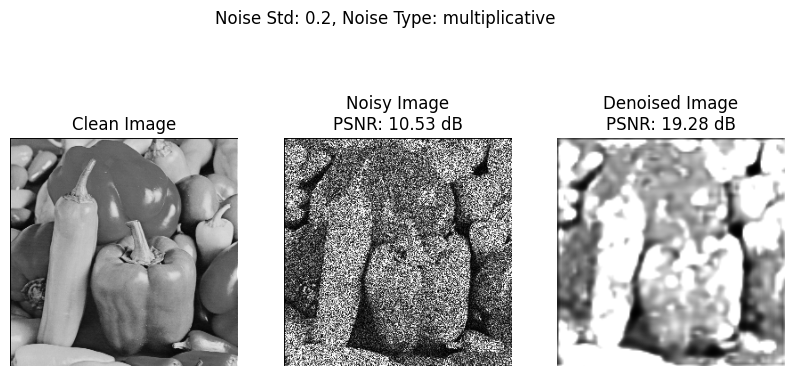

Image: peppers256.tif, Noise Std: 0.3
Average PSNR (Noisy): 11.13 dB, Average PSNR (Denoised): 20.11 dB
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.11940208822488785
Step 10, Loss: 0.08698401600122452
Step 20, Loss: 0.08312247693538666
Step 30, Loss: 0.08090470731258392
Step 40, Loss: 0.07880154252052307
Step 50, Loss: 0.07665559649467468
Step 60, Loss: 0.0743570327758789
Step 70, Loss: 0.07277943938970566
Step 80, Loss: 0.07189463824033737
Step 90, Loss: 0.07116666436195374
Step 100, Loss: 0.07047472894191742
Step 110, Loss: 0.06993020325899124
Step 120, Loss: 0.06940693408250809
Step 130, Loss: 0.06895465403795242
Step 140, Loss: 0.06853984296321869
Step 150, Loss: 0.06814011186361313
Step 160, Loss: 0.06781554222106934
Step 170, Loss: 0.06747753173112869
Step 180, Loss: 0.06772791594266891
Step 190, Loss: 0.06699006259441376
Time lapsed 17.100512504577637


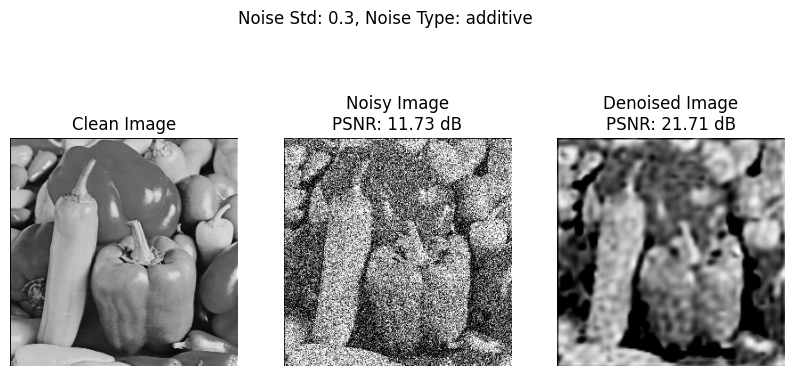

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.21160529553890228
Step 10, Loss: 0.10081887990236282
Step 20, Loss: 0.0979745015501976
Step 30, Loss: 0.0924026221036911
Step 40, Loss: 0.09148912876844406
Step 50, Loss: 0.09008768200874329
Step 60, Loss: 0.08926937729120255
Step 70, Loss: 0.08849747478961945
Step 80, Loss: 0.0876568928360939
Step 90, Loss: 0.08676018565893173
Step 100, Loss: 0.08614549040794373
Step 110, Loss: 0.08574517071247101
Step 120, Loss: 0.08534475415945053
Step 130, Loss: 0.08502985537052155
Step 140, Loss: 0.08473443239927292
Step 150, Loss: 0.08445684611797333
Step 160, Loss: 0.08420908451080322
Step 170, Loss: 0.08398636430501938
Step 180, Loss: 0.08385449647903442
Step 190, Loss: 0.08353294432163239
Time lapsed 17.070774793624878


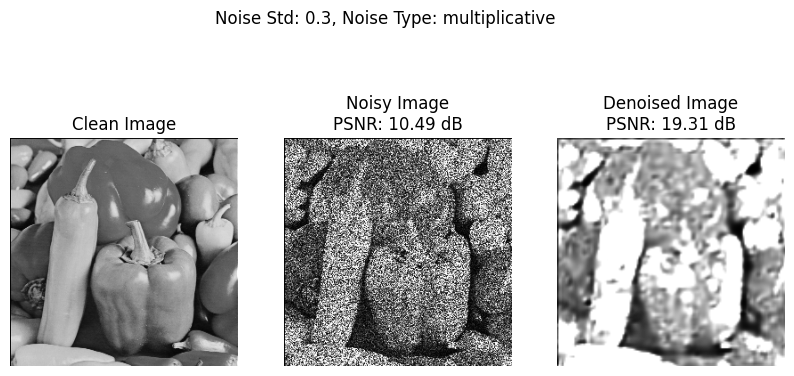

In [ ]:
import os
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2
import math
import time

def save_figure_as_image(figure, filename):
    figure.savefig(filename)

def evaluate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images

def add_multiplicative_noise(image, noise_std):
    noise = np.random.normal(scale=1, size=image.shape)
    noisy_image = (image) * (noise)
    return noisy_image

import os
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2

import time

def save_figure_as_image(figure, filename):
    figure.savefig(filename)


image_paths = [
    'barbara.tif', 'cameraman.tif', 'house.tif',
    'Monarch.tif', 'peppers256.tif'
]


def evaluate_psnr(clean_image, noisy_image, denoised_image):
    # Resize denoised image to match clean_image
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images


images = load_images(image_paths)

def add_multiplicative_noise(image, noise_std):
  noise=np.random.normal(scale=1, size=image.shape)
  noisy_image =(image)*(noise)
  return noisy_image

def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

def process_image(clean_image_np, noise_std):
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    return noisy_image


def project_DIP(x_temp, layer):
    # Initialize the input with Gaussian noise
    n1,n2 = x_temp.shape

    # print('size input:', n1,n2)
    # sizen1 = size_input/16;
    # sizen1 = int(size_input / 16)
    # print("input_size",size_input )
    # print("sizen1", sizen1)
    sizen1 = int(n1/8)
    print(sizen1)
    input_tensor = torch.randn(1, 64, sizen1, sizen1)

    print("input_tensor_size",  input_tensor.size())


    if not isinstance(x_temp, torch.Tensor):
        x_temp = torch.from_numpy(x_temp).float()   #

    if(layer ==2):
      model = model_dip_two_layers()
    elif(layer ==3):
      model = model_dip_three_layers()
    elif (layer==4):
        model = model_dip_four_layers()
    elif(layer==5):
        model = model_dip_five_layers()
    else:
        model = model_dip_three_layers()



    optimizer = optim.Adam(model.parameters(), lr=0.05)
    criterion = nn.MSELoss()

    loss_history =[]
    start_time = time.time()
    num_steps=200
    for step in range(num_steps):
        optimizer.zero_grad()
        output=model(input_tensor)

        # print("output shape", output.shape)
        output_resized = F.interpolate(output, size=x_temp.shape[-2:], mode='bilinear', align_corners=False)

        # Then calculate the loss with the resized output
        loss = criterion(output_resized, x_temp)
        loss_history.append(loss.item())

        # loss = criterion(output,x_temp)
        loss.backward()
        optimizer.step()

        if step % 10 == 0:
            print(f"Step {step}, Loss: {loss.item()}")
    end_time = time.time()
    time_elapsed = end_time - start_time
    print("Time lapsed", time_elapsed)

    output_np = output.squeeze().detach().numpy()

    return output_np, loss_history, time_elapsed


image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]

images = load_images(image_paths)

psnr_data = []


def denoise_image_with_DIP(clean_image_np, noise_type, noise_std):
    if noise_type == 'additive':
        noisy_image = add_additive_noise(clean_image_np, noise_std)
    elif noise_type == 'multiplicative':
        noisy_image = add_multiplicative_noise(clean_image_np, noise_std)
        noisy_image = np.abs(np.sqrt(math.pi / 2) * noisy_image)
        noisy_image = np.clip(noisy_image, 0, 1)
    else:
        raise ValueError("Invalid noise type. Choose 'additive' or 'multiplicative'.")

    denoised_image, _, _ = project_DIP(noisy_image, layer=3)

    return clean_image_np, noisy_image, denoised_image

noise_std_levels = [0.1, 0.2, 0.3]

accumulated_psnr_results = {}

for image_path in image_paths:
    clean_image_np = load_images([image_path])[0]

    for noise_std in noise_std_levels:
        for noise_type in ['additive', 'multiplicative']:
            clean_image, noisy_image, denoised_image = denoise_image_with_DIP(clean_image_np, noise_type, noise_std)
            psnr_noisy, psnr_denoised = evaluate_psnr(clean_image, noisy_image, denoised_image)

            if (image_path, noise_std) not in accumulated_psnr_results:
                accumulated_psnr_results[(image_path, noise_std)] = {'noisy': 0, 'denoised': 0, 'count': 0}
            accumulated_psnr_results[(image_path, noise_std)]['noisy'] += psnr_noisy
            accumulated_psnr_results[(image_path, noise_std)]['denoised'] += psnr_denoised
            accumulated_psnr_results[(image_path, noise_std)]['count'] += 1

average_psnr_results = {}
for key, value in accumulated_psnr_results.items():
    image_path, noise_std = key
    noisy_psnr_avg = value['noisy'] / value['count']
    denoised_psnr_avg = value['denoised'] / value['count']
    average_psnr_results[key] = (noisy_psnr_avg, denoised_psnr_avg)

for key, value in average_psnr_results.items():
    image_path, noise_std = key
    noisy_psnr_avg, denoised_psnr_avg = value
    print(f"Image: {image_path}, Noise Std: {noise_std}")
    print(f"Average PSNR (Noisy): {noisy_psnr_avg:.2f} dB, Average PSNR (Denoised): {denoised_psnr_avg:.2f} dB")

    clean_image_np = load_images([image_path])[0]
    for noise_type in ['additive', 'multiplicative']:
        clean_image, noisy_image, denoised_image = denoise_image_with_DIP(clean_image_np, noise_type, noise_std)
        psnr_noisy, psnr_denoised = evaluate_psnr(clean_image, noisy_image, denoised_image)
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(clean_image, cmap='gray')
        plt.title('Clean Image')
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(noisy_image, cmap='gray')
        plt.title(f'Noisy Image\nPSNR: {psnr_noisy:.2f} dB')
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(denoised_image, cmap='gray')
        plt.title(f'Denoised Image\nPSNR: {psnr_denoised:.2f} dB')
        plt.axis('off')
        plt.suptitle(f'Noise Std: {noise_std}, Noise Type: {noise_type}')
        plt.show()




---


**Explanation of the code block**: The code above tests a series of images, who is path is indicated by image_paths, and tests the denoising PSNR rate depending on additive vs multiplicative noise.In this particular code block, we test to see if the power of noise has an effect on the reconstruction quality, as indicated by the PSNR. We test the impact of the following power of noise coefficients:  [0.1, 0.2, 0.3], as represented by the variable noise_std_levels, to see if the reconstruction quality is better at a particular level.




---


**Analysis of results:**
Through the results above, we can see that that the value fo power of noise changes the PSNR for the denosied image significantly for additive noise. However, for multiplitcative noise, the value is not changed by much. This means that power of noise has an effect in additive noise, but not multiplicative noise.

Additionally, for additive noise, we see that generally, a lower power of noise(lower as in 0.1), has a better denoised PSNR rate. a big reason for this is because when power of nosie is higher, the noisy image's PSNR is much lower, so it has more to denoise in the output image. At the same time, something interesting worth noting is that at higher PSNR, the image has to do much more more to recover oroginal image, and does a comparitivly good job - since it's able to denoise from low PSNR of around 12 to 22, while for 0.1 power of noise, it only denoises from 20 to 24.

# Patch Sizes

In [24]:
#defining functions needed to run tests on different patch sizes in the next code block

import math
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from PIL import Image
import numpy as np
import time
import matplotlib.pyplot as plt


def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
    return images

def evaluate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

# 3 layers
import matplotlib.pyplot as plt

class model_dip_three_layers(nn.Module):
    def __init__(self):
        super(model_dip_three_layers, self).__init__()

        # Layer 1: Conv+ReLU+Batch,
        self.up1 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 32x32 output
        )

        # Layer 2: Conv+ReLU+Batch
        self.up2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

        # Layer 3: Conv+ReLU+Batch
        self.up3 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
           nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )
        self.up4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 64x64 output
        )

         # Layer 4: Conv+ReLU+Batch
        self.up5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )

        self.up6 = nn.Sequential(
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(1),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)  # Ensures 128x128 output
        )


        # Final Layer: Conv+Sigmoid,
        self.final = nn.Sequential(
            nn.Conv2d(1, 1, kernel_size=1, padding=0),
            nn.Sigmoid()
            # sigmoid bounds the output
        )

    def forward(self, x):
        x = self.up1(x)
        x = self.up2(x)
        # x = self.up3(x)
        # x = self.up4(x)
        # x = self.up5(x)
        x = self.up6(x)

        x = self.final(x)
        return x
import os
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2
import time

def project_DIP_patches(x_temp, layer, noisy_image, image_np):
    # Initialize the input with Gaussian noise
    n1,n2 = x_temp.shape

    # print('size input:', n1,n2)
    # sizen1 = size_input/16;s
    # sizen1 = int(size_input / 16)
    # print("input_size",size_input )
    # print("sizen1", sizen1)
    sizen1 = int(n1/8)
    print(sizen1)
    input_tensor = torch.randn(1, 64, sizen1, sizen1)  # (batch_size, channels, height, width)

    print("input_tensor_size",  input_tensor.size())


    if not isinstance(x_temp, torch.Tensor):
        x_temp = torch.from_numpy(x_temp).float()   # Convert to tensor if it's a numpy array


    model = model_dip_three_layers()




    optimizer = optim.Adam(model.parameters(), lr=0.05)
    criterion = nn.MSELoss()

    loss_history =[]
    start_time = time.time()
    num_steps=200
    for step in range(num_steps):
        optimizer.zero_grad()
        output=model(input_tensor)

        # print("output shape", output.shape)
        output_resized = F.interpolate(output, size=x_temp.shape[-2:], mode='bilinear', align_corners=False)

        # Then calculate the loss with the resized output
        loss = criterion(output_resized, x_temp)
        loss_history.append(loss.item())

        # loss = criterion(output,x_temp)
        loss.backward()
        optimizer.step()

        if step % 10 == 0:
            print(f"Step {step}, Loss: {loss.item()}")
    end_time = time.time()
    time_elapsed = end_time - start_time
    print("Time lapsed", time_elapsed)

    output_np = output.squeeze().detach().numpy()
    psnr_noisy, psnr_denoised = evaluate_psnr(image_np, noisy_image, output_np)

    print("psnr", psnr_denoised)


    return output_np, loss_history, time_elapsed



import os
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import cv2
import math

import time

def save_figure_as_image(figure, filename):
    figure.savefig(filename)

def evaluate_psnr(clean_image, noisy_image, denoised_image):
    if denoised_image.shape != clean_image.shape:
        denoised_image = cv2.resize(denoised_image, (clean_image.shape[1], clean_image.shape[0]), interpolation=cv2.INTER_AREA)

    max_pixel = 1
    mse_noisy = np.mean((clean_image - noisy_image) ** 2)
    mse_denoised = np.mean((clean_image - denoised_image) ** 2)
    psnr_noisy = 10 * np.log10(max_pixel ** 2 / mse_noisy)
    psnr_denoised = 10 * np.log10(max_pixel ** 2 / mse_denoised)
    return psnr_noisy, psnr_denoised

def load_images(paths):
    images = []
    for path in paths:
        img = Image.open(path).convert('L')
        images.append(np.array(img, dtype=np.float32) / 255.0)
        # Normalize to [0, 1]
    return images

def add_multiplicative_noise(image, noise_std):
    noise = np.random.normal(scale=1, size=image.shape)
    noisy_image = (image) * (noise)
    return noisy_image




32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.13526350259780884
Step 10, Loss: 0.09731058031320572
Step 20, Loss: 0.09190637618303299
Step 30, Loss: 0.08897005021572113
Step 40, Loss: 0.08794204890727997
Step 50, Loss: 0.08685925602912903
Step 60, Loss: 0.0861377939581871
Step 70, Loss: 0.08547234535217285
Step 80, Loss: 0.08483297377824783
Step 90, Loss: 0.08448135852813721
Step 100, Loss: 0.08375220745801926
Step 110, Loss: 0.08327335119247437
Step 120, Loss: 0.0827844962477684
Step 130, Loss: 0.08257061243057251
Step 140, Loss: 0.08171844482421875
Step 150, Loss: 0.08220165967941284
Step 160, Loss: 0.08105374872684479
Step 170, Loss: 0.08026295155286789
Step 180, Loss: 0.0797913670539856
Step 190, Loss: 0.07976114004850388
Time lapsed 23.305680751800537
psnr 17.3958595364491
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.117397740483284
Step 10, Loss: 0.09810023009777069
Step 20, Loss: 0.0912630632519722
Step 30, Loss: 0.08935833722352982
Step 40

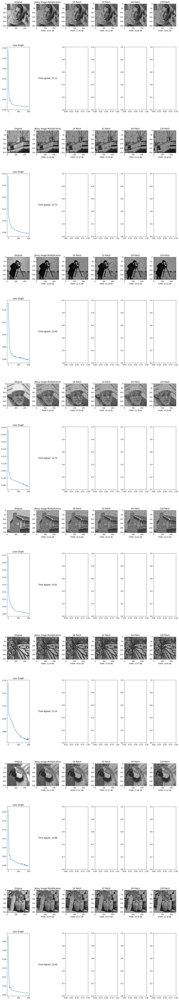

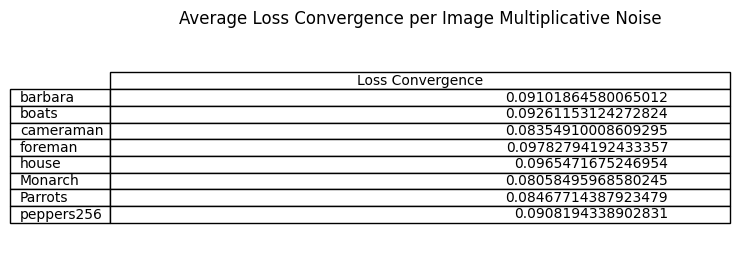

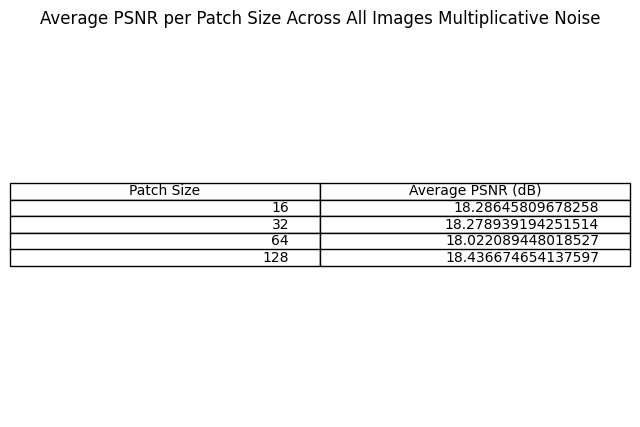

In [25]:
# image paths that we want to test
image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]

images = load_images(image_paths)

# fig, axs = plt.subplots(len(images) * 2, 5, figsize=(15, 5 * len(images)))
fig, axs = plt.subplots(len(images) * 2 , 6, figsize=(15, 5 * (len(images) * 2 + 1)))

best_psnr_per_image = []
patch_sizes=[16, 32, 64, 128]

psnr_values_per_patch = [[] for _ in range(len(patch_sizes))]

loss_table_data = []
for i, clean_image_np in enumerate(images):
    axs[i * 2, 0].imshow(clean_image_np, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 0].set_title('Original')

    noise_std = 0.1
    noisy_image = add_multiplicative_noise(clean_image_np, noise_std)
    noisy_image = np.abs(np.sqrt(math.pi/2) * noisy_image)
    noisy_image = np.clip(noisy_image, 0, 1)
    axs[i * 2, 1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 1].set_title('Noisy Image Multiplicative')
    psnr_noisy, _ = evaluate_psnr(clean_image_np, noisy_image, noisy_image)
    axs[i * 2, 1].text(0.5, -0.2, f'PSNR: {psnr_noisy:.2f} dB', horizontalalignment='center', verticalalignment='center', transform=axs[i * 2, 1].transAxes, fontsize=10)

    for j, patch_size in enumerate(patch_sizes):
        denoised_image, loss_history, time_elapsed = project_DIP_patches(noisy_image, 3, patch_size,clean_image_np)
        psnr_noisy_multiplicative, psnr_denoised_multiplicative = evaluate_psnr(clean_image_np, noisy_image, denoised_image)
        axs[i * 2, j + 2].imshow(denoised_image, cmap='gray', vmin=0, vmax=1)
        axs[i * 2, j + 2].set_title(f'{patch_size} Patch')

        # axs[i * 2, j + 2].text(0.5, -0.2, f'PSNR: {psnr_denoised_multiplicative:.2f} dB',
        #                         horizontalalignment='center', verticalalignment='center',
        #                         transform=axs[i * 2, j + 2].transAxes, fontsize=10)
        axs[i * 2, j + 2].text(0.5, -0.2, f'PSNR: {psnr_denoised_multiplicative:.2f} dB',
                                horizontalalignment='center', verticalalignment='center',
                                transform=axs[i * 2, j + 2].transAxes, fontsize=10)

        psnr_values_per_patch[j].append(psnr_denoised_multiplicative)

    axs[i * 2 + 1, 0].plot(loss_history)
    axs[i * 2 + 1, 0].set_title('Loss Graph')

    axs[i * 2 + 1, 1].text(0.5, 0.5, f'Time lapsed: {time_elapsed:.2f}', horizontalalignment='center', verticalalignment='center', fontsize=12)
    axs[i * 2 + 1, 1].axis('off')

    if psnr_values_per_patch[-1]:
        best_psnr = max(psnr_values_per_patch[-1])
        best_psnr_per_image.append(best_psnr)
    else:
        best_psnr_per_image.append(0)

    loss_table_data.append(loss_history)

plt.subplots_adjust(hspace=0.5)

plt.tight_layout()  # Adjust layout
plt.show()

average_loss_convergence = np.mean(np.array(loss_table_data), axis=1)

table_columns = ['Loss Convergence']
table_rows = [os.path.splitext(os.path.basename(path))[0] for path in image_paths]
plt.figure(figsize=(8, 3))
plt.axis('off')
plt.table(cellText=average_loss_convergence.reshape(-1, 1), colLabels=table_columns, rowLabels=table_rows, loc='center')
plt.title('Average Loss Convergence per Image Multiplicative Noise')
plt.show()

average_psnr_per_patch = [np.mean(psnr_values) for psnr_values in psnr_values_per_patch]

table_columns = ['Patch Size', 'Average PSNR (dB)']
table_data = [[patch_sizes[i], average_psnr_per_patch[i]] for i in range(len(patch_sizes))]

plt.figure(figsize=(8, 5))
plt.axis('off')
plt.table(cellText=table_data, colLabels=table_columns, loc='center')
plt.title('Average PSNR per Patch Size Across All Images Multiplicative Noise')
plt.show()


**Explanation of the code block:**
In this code block, we put a series of images throught the dip model, and test their ability to denoise multiplicative noise images, based on their patch size, to see if different patch sizes deliver better image reconstruction.  

---



**Analysis of results:** It looks like generally, the patch size of 128 gives the best denoising results, with the average at 18.022

32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.0791780948638916
Step 10, Loss: 0.022266430780291557
Step 20, Loss: 0.020674878731369972
Step 30, Loss: 0.017969824373722076
Step 40, Loss: 0.016927272081375122
Step 50, Loss: 0.016238614916801453
Step 60, Loss: 0.015782156959176064
Step 70, Loss: 0.015421164222061634
Step 80, Loss: 0.015162728726863861
Step 90, Loss: 0.014946907758712769
Step 100, Loss: 0.014767085202038288
Step 110, Loss: 0.01460402924567461
Step 120, Loss: 0.014439718797802925
Step 130, Loss: 0.01429167203605175
Step 140, Loss: 0.01416579820215702
Step 150, Loss: 0.013963093049824238
Step 160, Loss: 0.013802966102957726
Step 170, Loss: 0.013803784735500813
Step 180, Loss: 0.013630961067974567
Step 190, Loss: 0.013534082099795341
Time lapsed 17.650694131851196
psnr 23.05820479888585
32
input_tensor_size torch.Size([1, 64, 32, 32])
Step 0, Loss: 0.07928533852100372
Step 10, Loss: 0.03238082304596901
Step 20, Loss: 0.024168014526367188
Step 30, Loss: 0.02

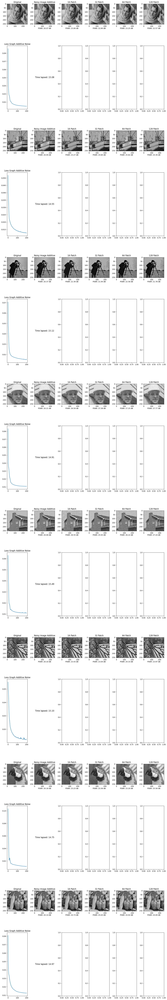

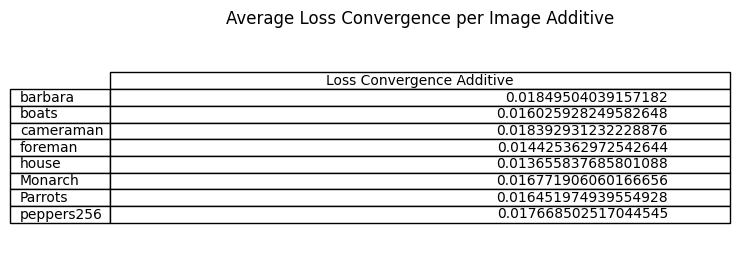

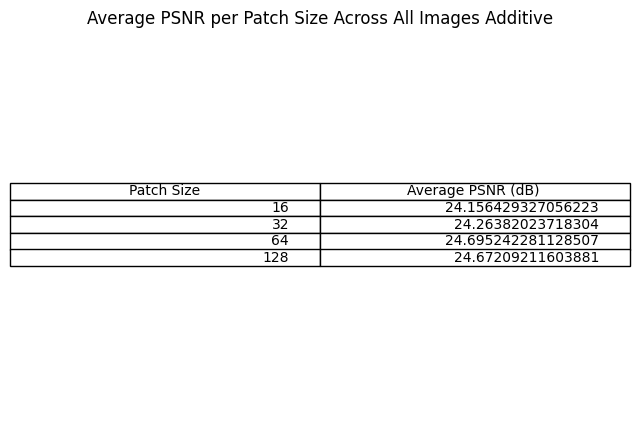

In [26]:

def add_additive_noise(image, noise_std):
  noise=np.random.normal(scale=noise_std, size=image.shape)
  noisy_image = image+noise
  noisy_image = np.clip(noisy_image, 0, 1)
  return noisy_image

  image_paths = [
    'barbara.tif', 'boats.tif', 'cameraman.tif',
    'foreman.tif', 'house.tif',
    'Monarch.tif', 'Parrots.tif', 'peppers256.tif'
]

images = load_images(image_paths)

# the plots:
# fig, axs = plt.subplots(len(images) * 2, 5, figsize=(15, 5 * len(images)))
fig, axs = plt.subplots(len(images) * 2 , 6, figsize=(14, 5 * (len(images) * 2 + 1)))


best_psnr_per_image = []
patch_sizes=[16, 32, 64, 128]

psnr_values_per_patch = [[] for _ in range(len(patch_sizes))]

loss_table_data = []
for i, clean_image_np in enumerate(images):
    axs[i * 2, 0].imshow(clean_image_np, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 0].set_title('Original')

    noise_std = 0.1
    noisy_image = add_additive_noise(clean_image_np, noise_std)
    axs[i * 2, 1].imshow(noisy_image, cmap='gray', vmin=0, vmax=1)
    axs[i * 2, 1].set_title('Noisy Image Additive')
    psnr_noisy, _ = evaluate_psnr(clean_image_np, noisy_image, noisy_image)
    axs[i * 2, 1].text(0.5, -0.2, f'PSNR: {psnr_noisy:.2f} dB', horizontalalignment='center', verticalalignment='center', transform=axs[i * 2, 1].transAxes, fontsize=10)

    for j, patch_size in enumerate(patch_sizes):
        denoised_image, loss_history, time_elapsed = project_DIP_patches(noisy_image, 3, patch_size,clean_image_np)
        psnr_noisy_additive, psnr_denoised_additive = evaluate_psnr(clean_image_np, noisy_image, denoised_image)
        axs[i * 2, j + 2].imshow(denoised_image, cmap='gray', vmin=0, vmax=1)
        axs[i * 2, j + 2].set_title(f'{patch_size} Patch')

        # axs[i * 2, j + 2].text(0.5, -0.2, f'PSNR: {psnr_denoised_multiplicative:.2f} dB',
        #                         horizontalalignment='center', verticalalignment='center',
        #                         transform=axs[i * 2, j + 2].transAxes, fontsize=10)
        axs[i * 2, j + 2].text(0.5, -0.2, f'PSNR: {psnr_denoised_additive:.2f} dB',
                                horizontalalignment='center', verticalalignment='center',
                                transform=axs[i * 2, j + 2].transAxes, fontsize=10)

        # Append PSNR values to list
        psnr_values_per_patch[j].append(psnr_denoised_additive)

    axs[i * 2 + 1, 0].plot(loss_history)
    axs[i * 2 + 1, 0].set_title('Loss Graph Additive Noise')

    axs[i * 2 + 1, 1].text(0.5, 0.5, f'Time lapsed: {time_elapsed:.2f}', horizontalalignment='center', verticalalignment='center', fontsize=12)
    axs[i * 2 + 1, 1].axis('off')

    if psnr_values_per_patch[-1]:
        best_psnr = max(psnr_values_per_patch[-1])
        best_psnr_per_image.append(best_psnr)
    else:
        best_psnr_per_image.append(0)

    loss_table_data.append(loss_history)

plt.subplots_adjust(hspace=0.5)

plt.tight_layout()
plt.show()

average_loss_convergence = np.mean(np.array(loss_table_data), axis=1)

table_columns = ['Loss Convergence Additive']
table_rows = [os.path.splitext(os.path.basename(path))[0] for path in image_paths]
plt.figure(figsize=(8, 3))
plt.axis('off')
plt.table(cellText=average_loss_convergence.reshape(-1, 1), colLabels=table_columns, rowLabels=table_rows, loc='center')
plt.title('Average Loss Convergence per Image Additive')
plt.show()

average_psnr_per_patch = [np.mean(psnr_values) for psnr_values in psnr_values_per_patch]

table_columns = ['Patch Size', 'Average PSNR (dB) ']
table_data = [[patch_sizes[i], average_psnr_per_patch[i]] for i in range(len(patch_sizes))]

plt.figure(figsize=(8, 5))
plt.axis('off')
plt.table(cellText=table_data, colLabels=table_columns, loc='center')
plt.title('Average PSNR per Patch Size Across All Images Additive')
plt.show()




---


**Explanation of the code block:**

In this code block, we put a series of images throught the dip model, and test their ability to denoise additive noise images, based on their patch size, to see if different patch sizes deliver better image reconstruction.  


---


**Analysis of results:** It looks like generally, the patch size of 64 gives the best denoising results, with the average at 24.695